<a href="https://colab.research.google.com/github/yijinong/zero-DCE/blob/main/zeroDCE_denoised3x3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import os
import random
import numpy as np
from glob import glob
from PIL import Image, ImageOps
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
!unzip -q /content/drive/MyDrive/lol_dataset.zip


In [4]:
IMAGE_SIZE = 256
BATCH_SIZE = 16
MAX_TRAIN_IMAGES = 400

def load_data(image_path):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_png(image, channels=3)
    image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
    image = image / 255.0
    return image

def data_generator(low_light_images):
    dataset = tf.data.Dataset.from_tensor_slices((low_light_images))
    dataset = dataset.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=True)
    return dataset

In [5]:
import os.path
from os import path

if path.exists('/content/lol_dataset/denoise_our485') == False:
  os.mkdir('/content/lol_dataset/denoise_our485')

os.chdir('/content/lol_dataset/denoise_our485')

Populating the interactive namespace from numpy and matplotlib
/content/lol_dataset/denoise_our485/663


/usr/local/lib/python3.8/dist-packages/IPython/core/magics/pylab.py:159: UserWarning: pylab import has clobbered these variables: ['random']
`%matplotlib` prevents importing * from pylab and numpy
  warn("pylab import has clobbered these variables: %s"  % clobbered +


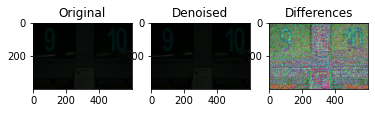

/content/lol_dataset/denoise_our485/676


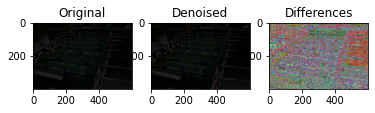

/content/lol_dataset/denoise_our485/220


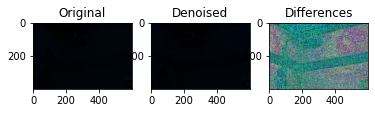

/content/lol_dataset/denoise_our485/703


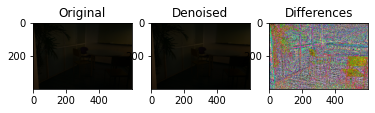

/content/lol_dataset/denoise_our485/700


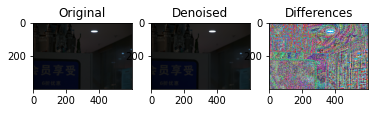

/content/lol_dataset/denoise_our485/528


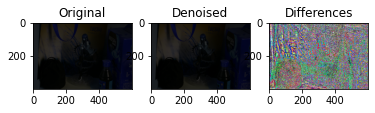

/content/lol_dataset/denoise_our485/10


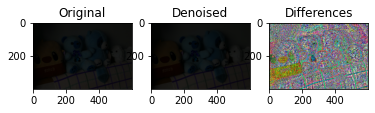

/content/lol_dataset/denoise_our485/529


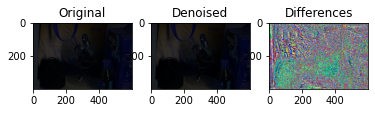

/content/lol_dataset/denoise_our485/776


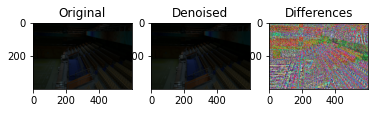

/content/lol_dataset/denoise_our485/51


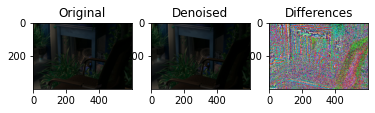

/content/lol_dataset/denoise_our485/553


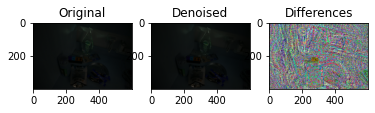

/content/lol_dataset/denoise_our485/649


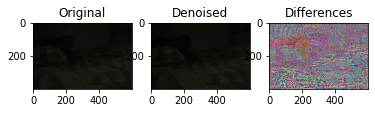

/content/lol_dataset/denoise_our485/543


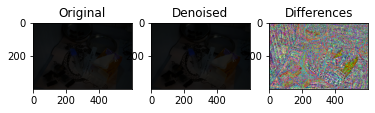

/content/lol_dataset/denoise_our485/114


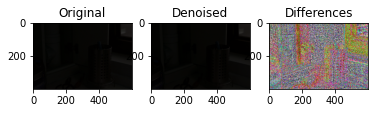

/content/lol_dataset/denoise_our485/222


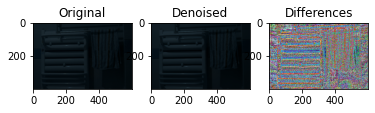

/content/lol_dataset/denoise_our485/506


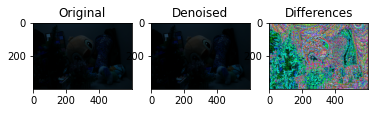

/content/lol_dataset/denoise_our485/701


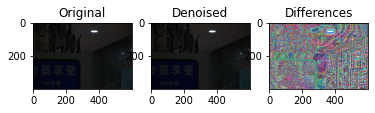

/content/lol_dataset/denoise_our485/540


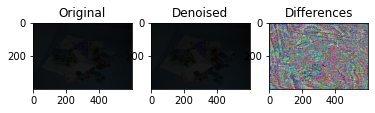

/content/lol_dataset/denoise_our485/535


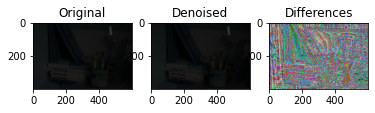

/content/lol_dataset/denoise_our485/517


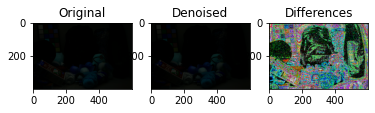

/content/lol_dataset/denoise_our485/682


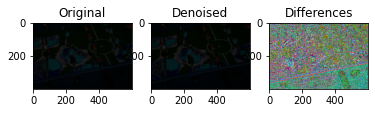

/content/lol_dataset/denoise_our485/468


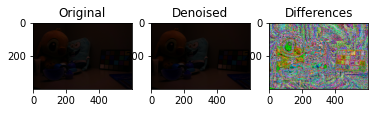

/content/lol_dataset/denoise_our485/95


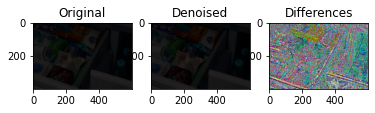

/content/lol_dataset/denoise_our485/737


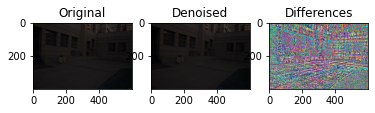

/content/lol_dataset/denoise_our485/259


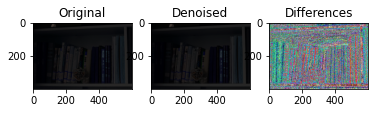

/content/lol_dataset/denoise_our485/512


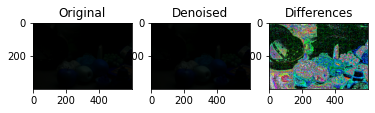

/content/lol_dataset/denoise_our485/680


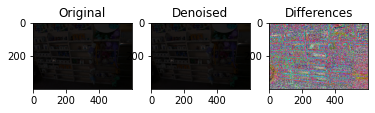

/content/lol_dataset/denoise_our485/42


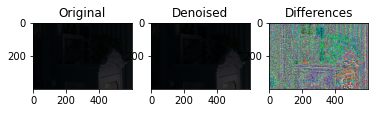

/content/lol_dataset/denoise_our485/611


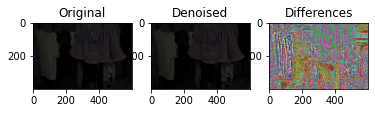

/content/lol_dataset/denoise_our485/175


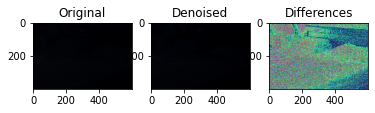

/content/lol_dataset/denoise_our485/150


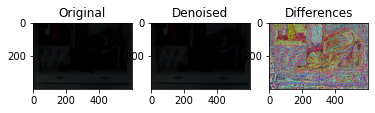

/content/lol_dataset/denoise_our485/530


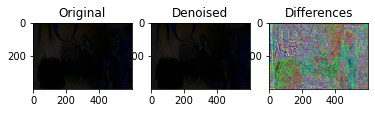

/content/lol_dataset/denoise_our485/209


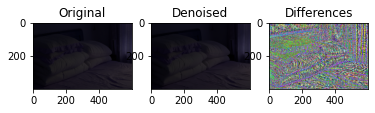

/content/lol_dataset/denoise_our485/25


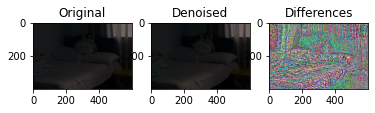

/content/lol_dataset/denoise_our485/757


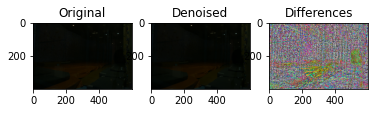

/content/lol_dataset/denoise_our485/495


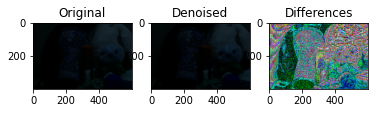

/content/lol_dataset/denoise_our485/344


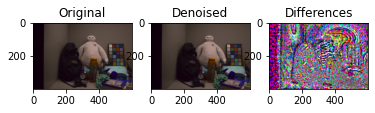

/content/lol_dataset/denoise_our485/569


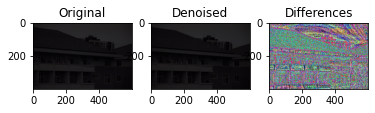

/content/lol_dataset/denoise_our485/787


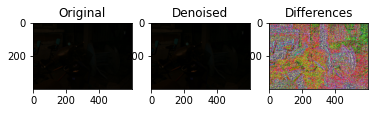

/content/lol_dataset/denoise_our485/637


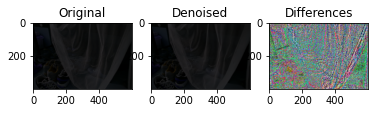

/content/lol_dataset/denoise_our485/565


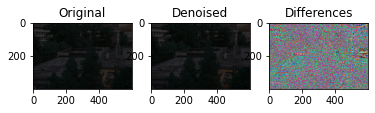

/content/lol_dataset/denoise_our485/212


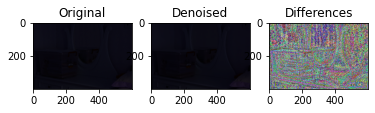

/content/lol_dataset/denoise_our485/219


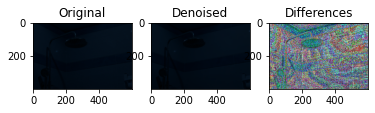

/content/lol_dataset/denoise_our485/498


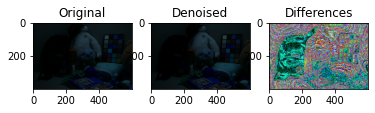

/content/lol_dataset/denoise_our485/666


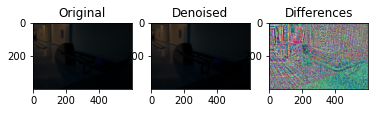

/content/lol_dataset/denoise_our485/122


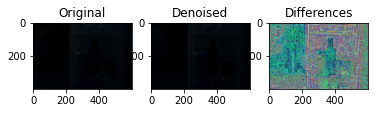

/content/lol_dataset/denoise_our485/620


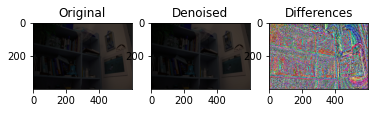

/content/lol_dataset/denoise_our485/472


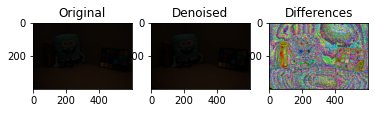

/content/lol_dataset/denoise_our485/541


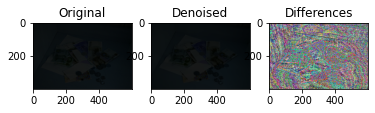

/content/lol_dataset/denoise_our485/253


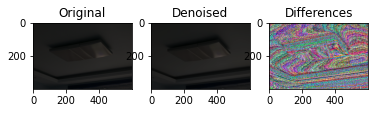

/content/lol_dataset/denoise_our485/119


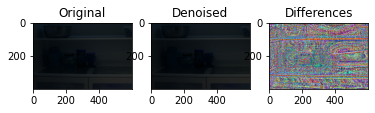

/content/lol_dataset/denoise_our485/594


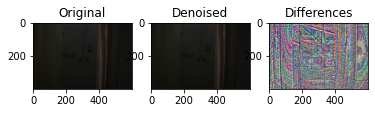

/content/lol_dataset/denoise_our485/542


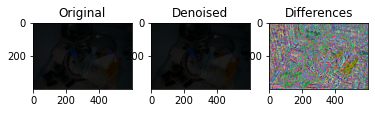

/content/lol_dataset/denoise_our485/460


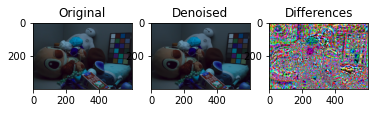

/content/lol_dataset/denoise_our485/647


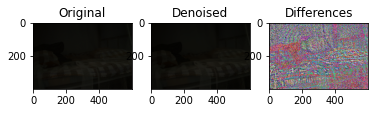

/content/lol_dataset/denoise_our485/15


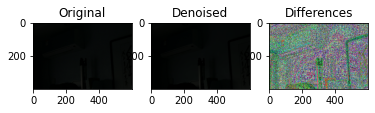

/content/lol_dataset/denoise_our485/720


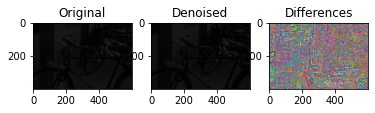

/content/lol_dataset/denoise_our485/769


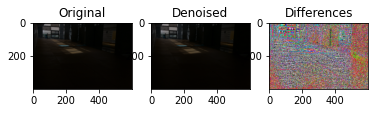

/content/lol_dataset/denoise_our485/39


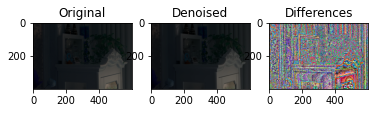

/content/lol_dataset/denoise_our485/627


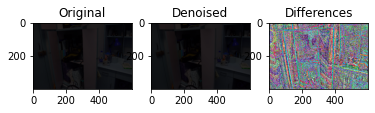

/content/lol_dataset/denoise_our485/747


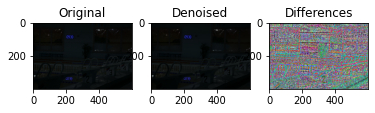

/content/lol_dataset/denoise_our485/45


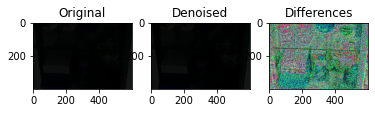

/content/lol_dataset/denoise_our485/628


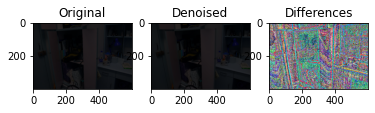

/content/lol_dataset/denoise_our485/593


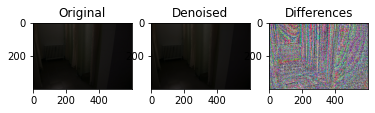

/content/lol_dataset/denoise_our485/575


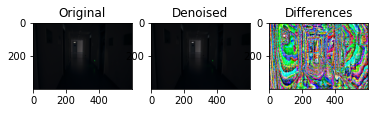

/content/lol_dataset/denoise_our485/53


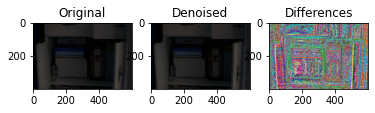

/content/lol_dataset/denoise_our485/782


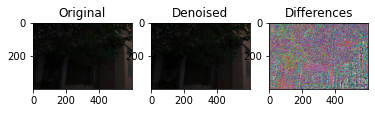

/content/lol_dataset/denoise_our485/764


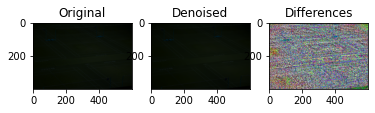

/content/lol_dataset/denoise_our485/532


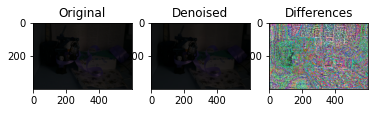

/content/lol_dataset/denoise_our485/549


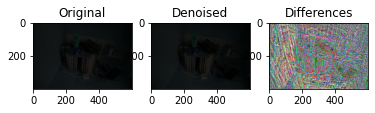

/content/lol_dataset/denoise_our485/526


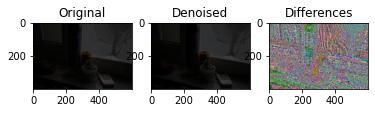

/content/lol_dataset/denoise_our485/687


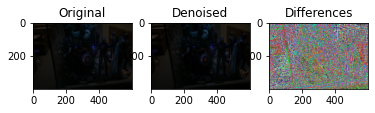

/content/lol_dataset/denoise_our485/21


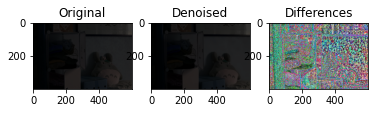

/content/lol_dataset/denoise_our485/725


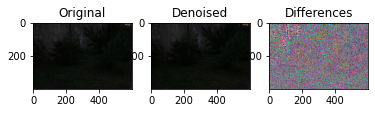

/content/lol_dataset/denoise_our485/560


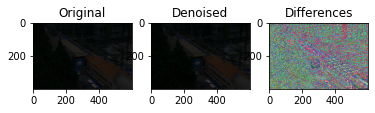

/content/lol_dataset/denoise_our485/709


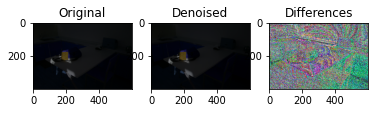

/content/lol_dataset/denoise_our485/567


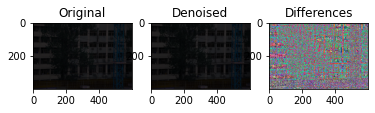

/content/lol_dataset/denoise_our485/622


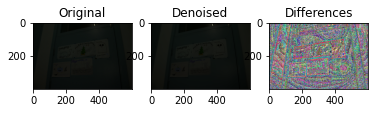

/content/lol_dataset/denoise_our485/130


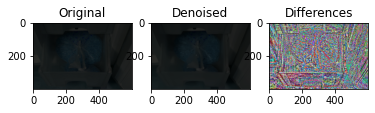

/content/lol_dataset/denoise_our485/17


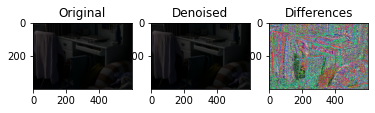

/content/lol_dataset/denoise_our485/47


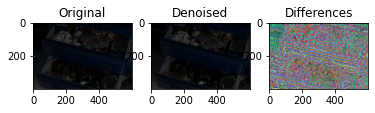

/content/lol_dataset/denoise_our485/693


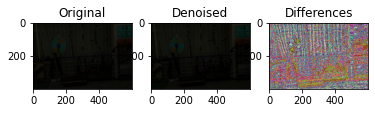

/content/lol_dataset/denoise_our485/773


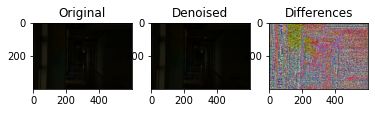

/content/lol_dataset/denoise_our485/531


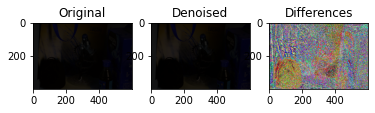

/content/lol_dataset/denoise_our485/109


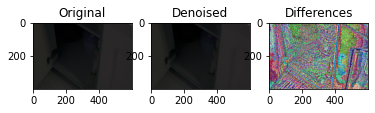

/content/lol_dataset/denoise_our485/18


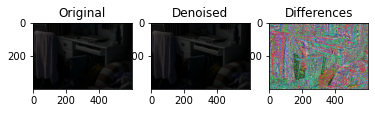

/content/lol_dataset/denoise_our485/117


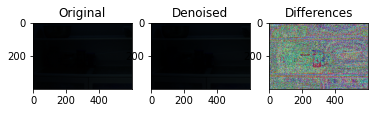

/content/lol_dataset/denoise_our485/185


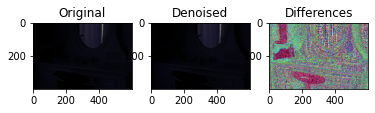

/content/lol_dataset/denoise_our485/40


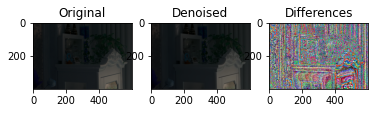

/content/lol_dataset/denoise_our485/105


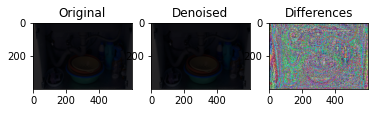

/content/lol_dataset/denoise_our485/745


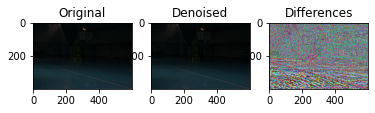

/content/lol_dataset/denoise_our485/83


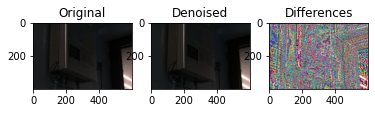

/content/lol_dataset/denoise_our485/728


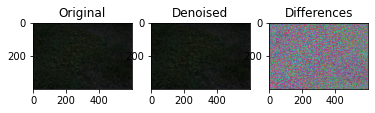

/content/lol_dataset/denoise_our485/104


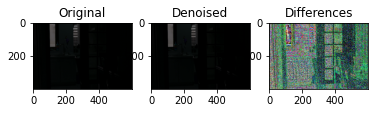

/content/lol_dataset/denoise_our485/686


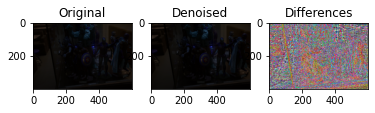

/content/lol_dataset/denoise_our485/604


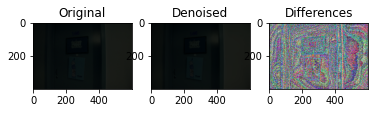

/content/lol_dataset/denoise_our485/112


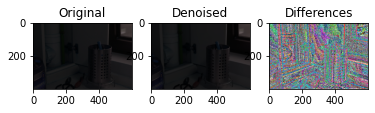

/content/lol_dataset/denoise_our485/690


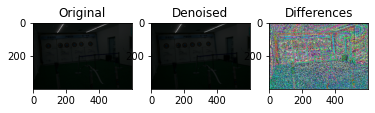

/content/lol_dataset/denoise_our485/600


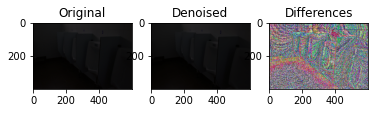

/content/lol_dataset/denoise_our485/145


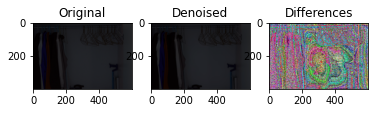

/content/lol_dataset/denoise_our485/486


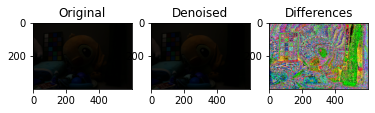

/content/lol_dataset/denoise_our485/139


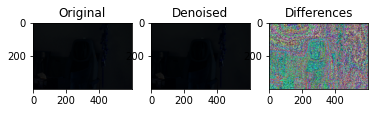

/content/lol_dataset/denoise_our485/450


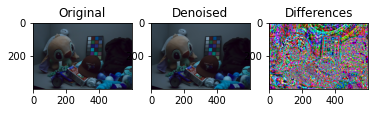

/content/lol_dataset/denoise_our485/103


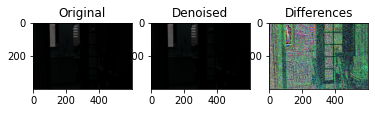

/content/lol_dataset/denoise_our485/781


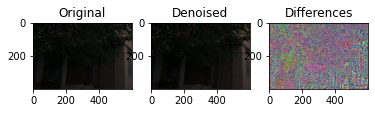

/content/lol_dataset/denoise_our485/24


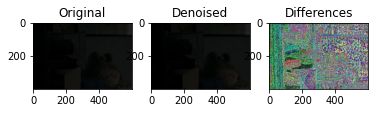

/content/lol_dataset/denoise_our485/568


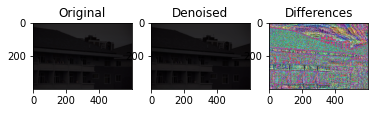

/content/lol_dataset/denoise_our485/612


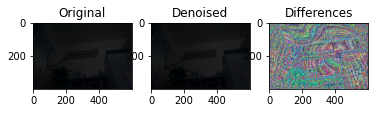

/content/lol_dataset/denoise_our485/475


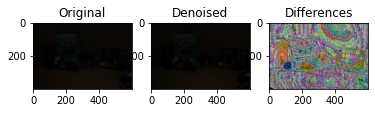

/content/lol_dataset/denoise_our485/644


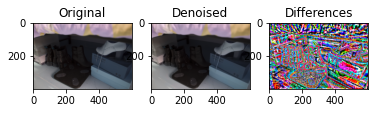

/content/lol_dataset/denoise_our485/490


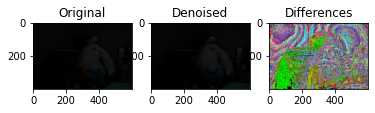

/content/lol_dataset/denoise_our485/534


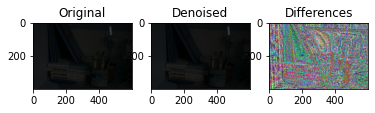

/content/lol_dataset/denoise_our485/712


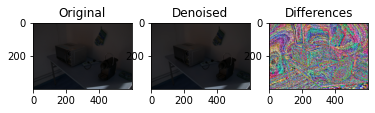

/content/lol_dataset/denoise_our485/167


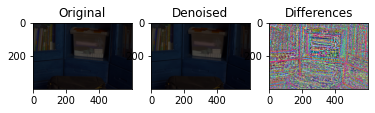

/content/lol_dataset/denoise_our485/191


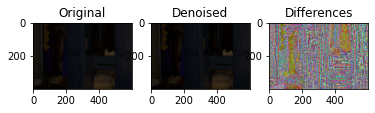

/content/lol_dataset/denoise_our485/35


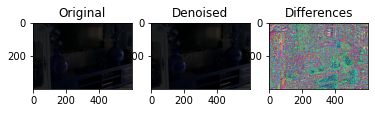

/content/lol_dataset/denoise_our485/714


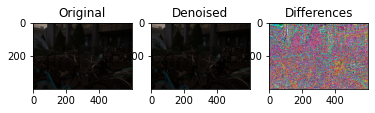

/content/lol_dataset/denoise_our485/761


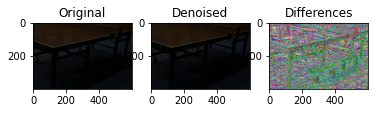

/content/lol_dataset/denoise_our485/101


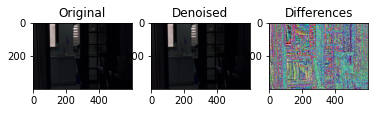

/content/lol_dataset/denoise_our485/92


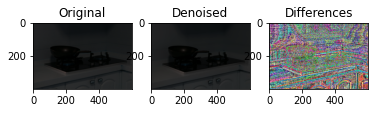

/content/lol_dataset/denoise_our485/786


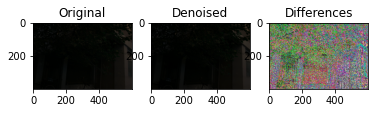

/content/lol_dataset/denoise_our485/621


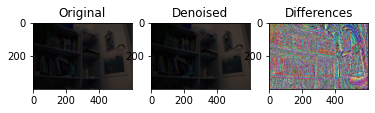

/content/lol_dataset/denoise_our485/729


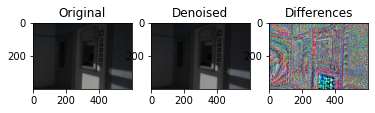

/content/lol_dataset/denoise_our485/227


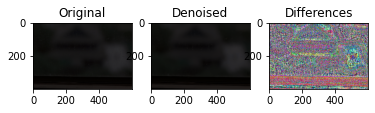

/content/lol_dataset/denoise_our485/655


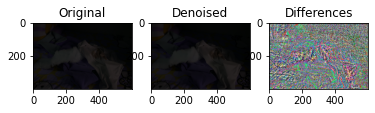

/content/lol_dataset/denoise_our485/228


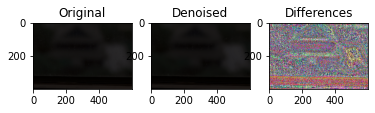

/content/lol_dataset/denoise_our485/147


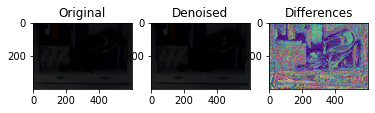

/content/lol_dataset/denoise_our485/607


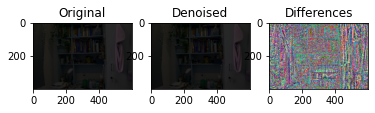

/content/lol_dataset/denoise_our485/64


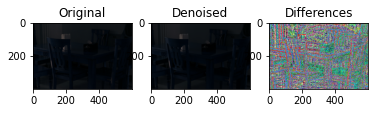

/content/lol_dataset/denoise_our485/154


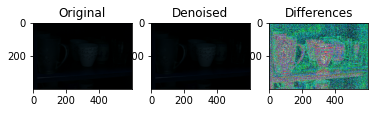

/content/lol_dataset/denoise_our485/246


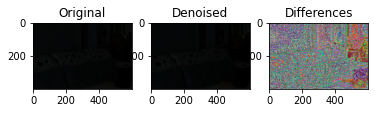

/content/lol_dataset/denoise_our485/758


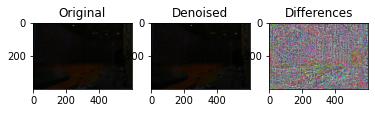

/content/lol_dataset/denoise_our485/724


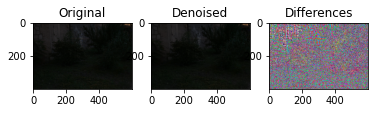

/content/lol_dataset/denoise_our485/99


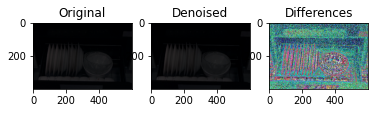

/content/lol_dataset/denoise_our485/100


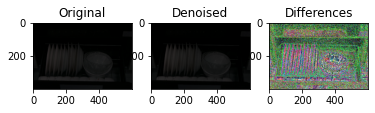

/content/lol_dataset/denoise_our485/144


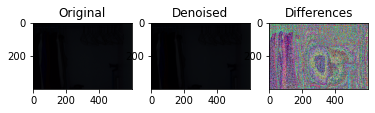

/content/lol_dataset/denoise_our485/675


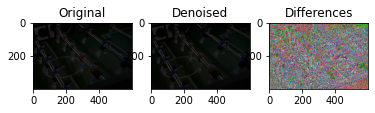

/content/lol_dataset/denoise_our485/198


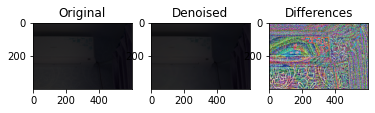

/content/lol_dataset/denoise_our485/598


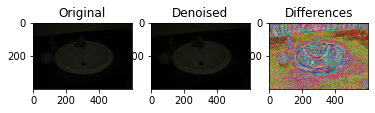

/content/lol_dataset/denoise_our485/169


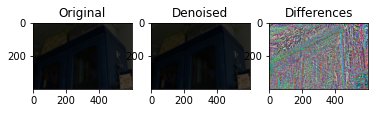

/content/lol_dataset/denoise_our485/679


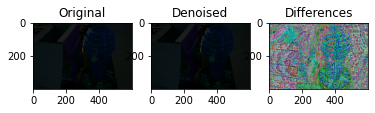

/content/lol_dataset/denoise_our485/172


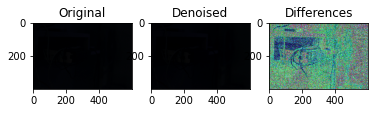

/content/lol_dataset/denoise_our485/785


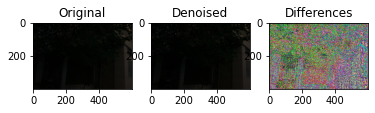

/content/lol_dataset/denoise_our485/583


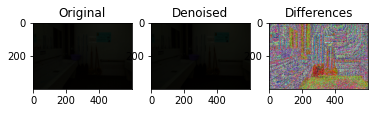

/content/lol_dataset/denoise_our485/609


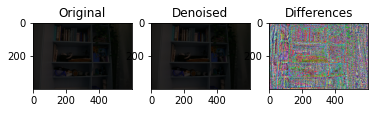

/content/lol_dataset/denoise_our485/783


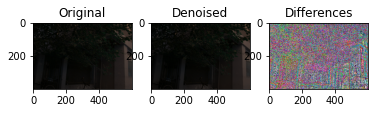

/content/lol_dataset/denoise_our485/740


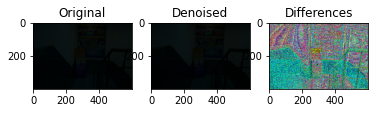

/content/lol_dataset/denoise_our485/243


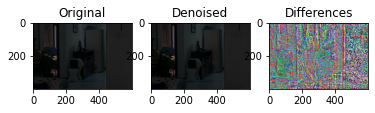

/content/lol_dataset/denoise_our485/477


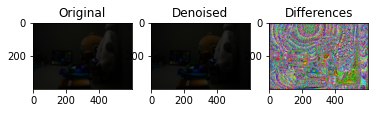

/content/lol_dataset/denoise_our485/524


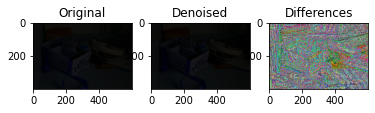

/content/lol_dataset/denoise_our485/96


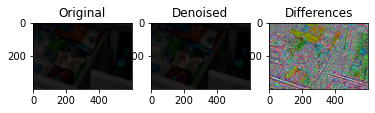

/content/lol_dataset/denoise_our485/479


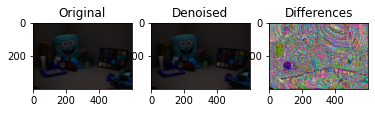

/content/lol_dataset/denoise_our485/474


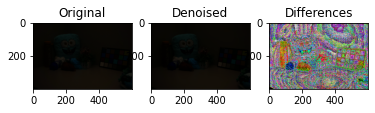

/content/lol_dataset/denoise_our485/54


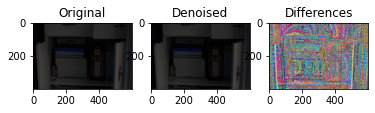

/content/lol_dataset/denoise_our485/120


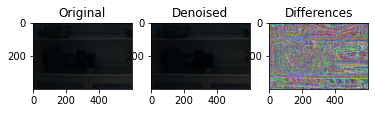

/content/lol_dataset/denoise_our485/624


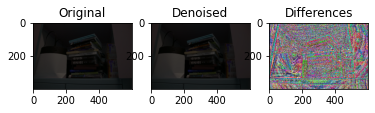

/content/lol_dataset/denoise_our485/659


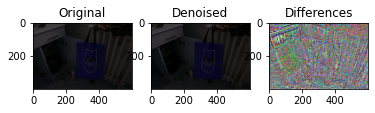

/content/lol_dataset/denoise_our485/231


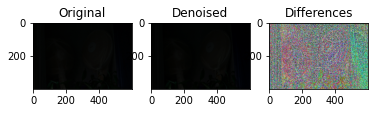

/content/lol_dataset/denoise_our485/491


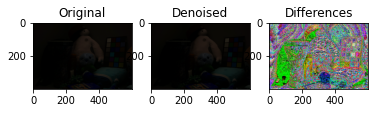

/content/lol_dataset/denoise_our485/188


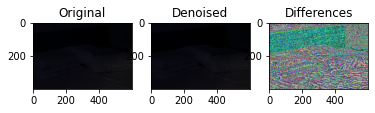

/content/lol_dataset/denoise_our485/496


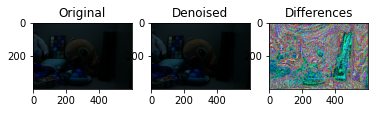

/content/lol_dataset/denoise_our485/157


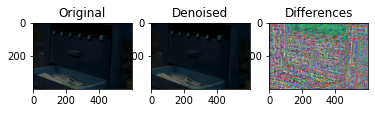

/content/lol_dataset/denoise_our485/6


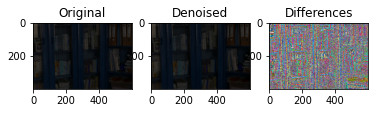

/content/lol_dataset/denoise_our485/739


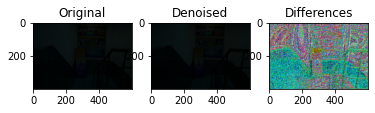

/content/lol_dataset/denoise_our485/123


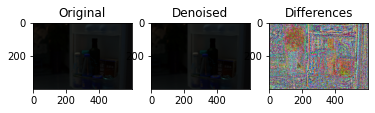

/content/lol_dataset/denoise_our485/75


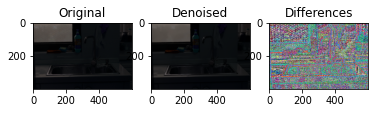

/content/lol_dataset/denoise_our485/654


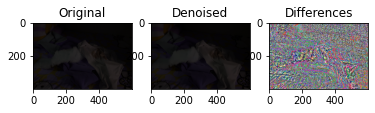

/content/lol_dataset/denoise_our485/492


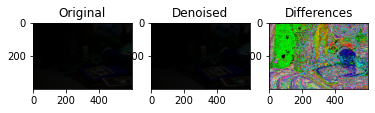

/content/lol_dataset/denoise_our485/629


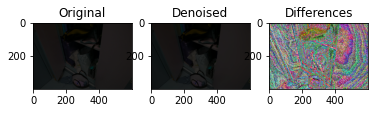

/content/lol_dataset/denoise_our485/115


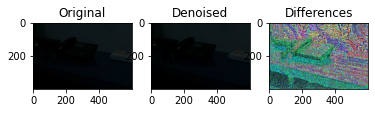

/content/lol_dataset/denoise_our485/759


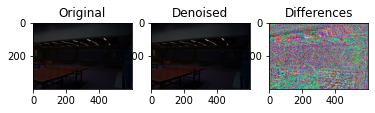

/content/lol_dataset/denoise_our485/788


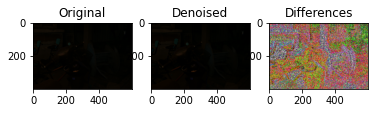

/content/lol_dataset/denoise_our485/229


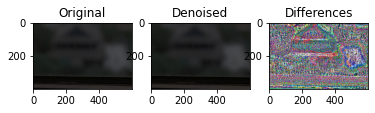

/content/lol_dataset/denoise_our485/533


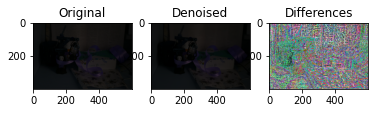

/content/lol_dataset/denoise_our485/478


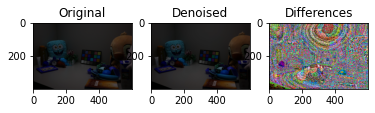

/content/lol_dataset/denoise_our485/595


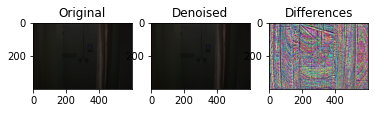

/content/lol_dataset/denoise_our485/483


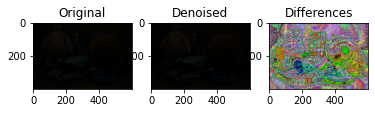

/content/lol_dataset/denoise_our485/58


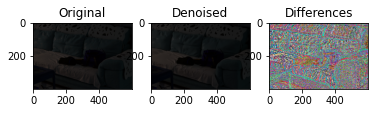

/content/lol_dataset/denoise_our485/251


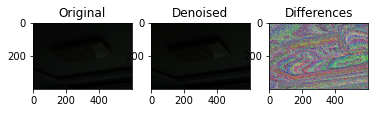

/content/lol_dataset/denoise_our485/33


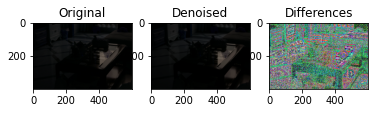

/content/lol_dataset/denoise_our485/638


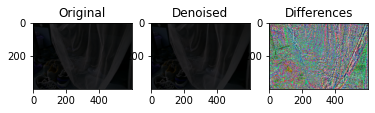

/content/lol_dataset/denoise_our485/777


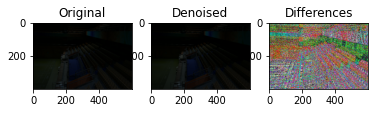

/content/lol_dataset/denoise_our485/537


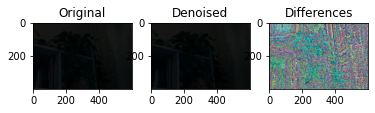

/content/lol_dataset/denoise_our485/688


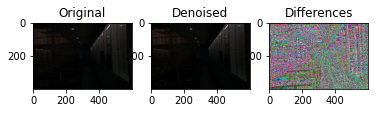

/content/lol_dataset/denoise_our485/84


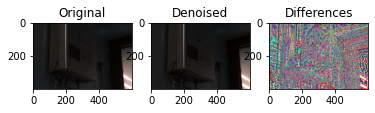

/content/lol_dataset/denoise_our485/501


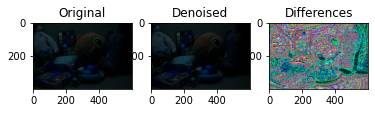

/content/lol_dataset/denoise_our485/765


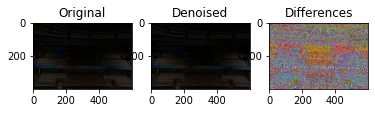

/content/lol_dataset/denoise_our485/497


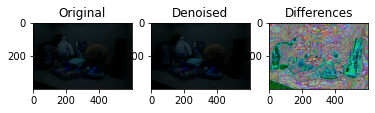

/content/lol_dataset/denoise_our485/664


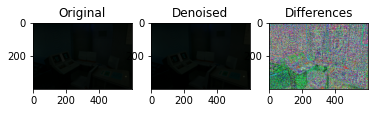

/content/lol_dataset/denoise_our485/716


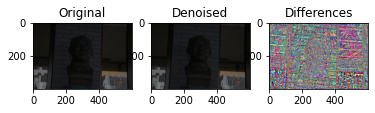

/content/lol_dataset/denoise_our485/601


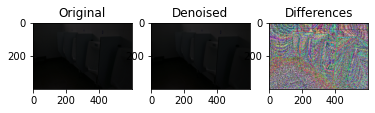

/content/lol_dataset/denoise_our485/482


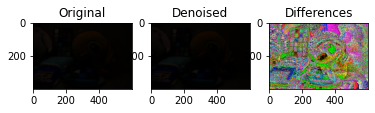

/content/lol_dataset/denoise_our485/710


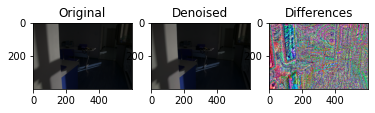

/content/lol_dataset/denoise_our485/480


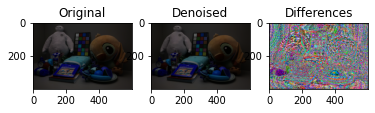

/content/lol_dataset/denoise_our485/330


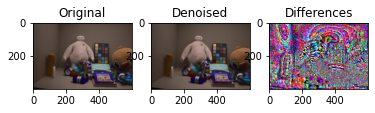

/content/lol_dataset/denoise_our485/136


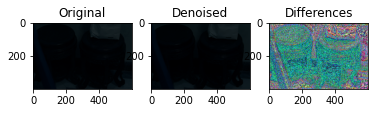

/content/lol_dataset/denoise_our485/481


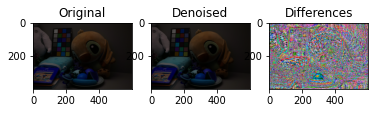

/content/lol_dataset/denoise_our485/267


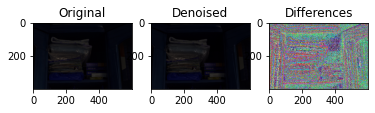

/content/lol_dataset/denoise_our485/81


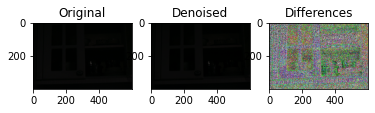

/content/lol_dataset/denoise_our485/61


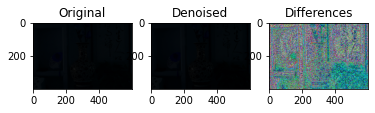

/content/lol_dataset/denoise_our485/151


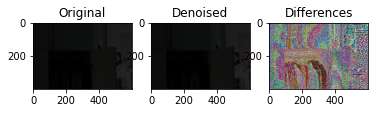

/content/lol_dataset/denoise_our485/590


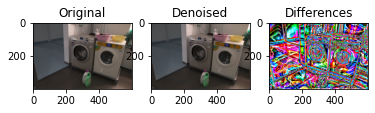

/content/lol_dataset/denoise_our485/476


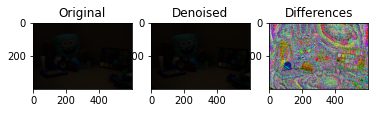

/content/lol_dataset/denoise_our485/67


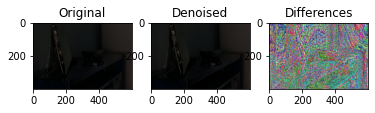

/content/lol_dataset/denoise_our485/514


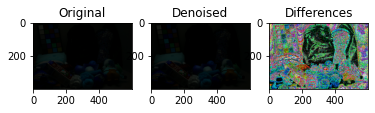

/content/lol_dataset/denoise_our485/551


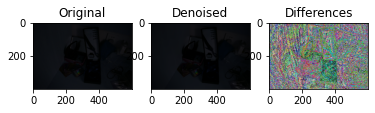

/content/lol_dataset/denoise_our485/633


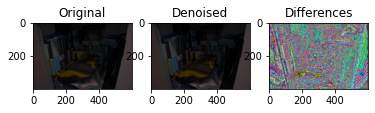

/content/lol_dataset/denoise_our485/14


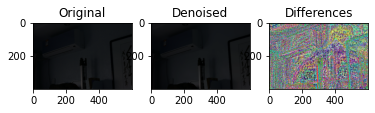

/content/lol_dataset/denoise_our485/695


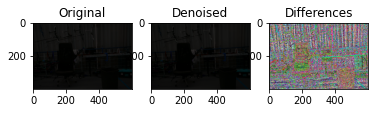

/content/lol_dataset/denoise_our485/546


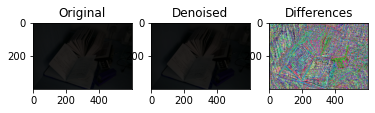

/content/lol_dataset/denoise_our485/721


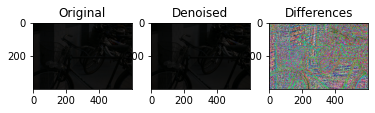

/content/lol_dataset/denoise_our485/650


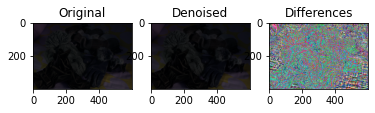

/content/lol_dataset/denoise_our485/184


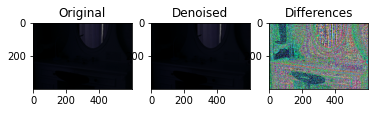

/content/lol_dataset/denoise_our485/80


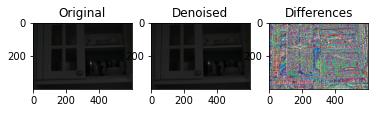

/content/lol_dataset/denoise_our485/26


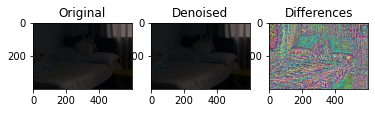

/content/lol_dataset/denoise_our485/77


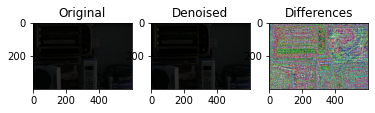

/content/lol_dataset/denoise_our485/194


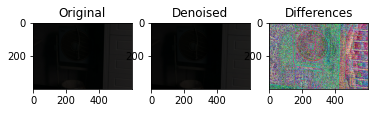

/content/lol_dataset/denoise_our485/717


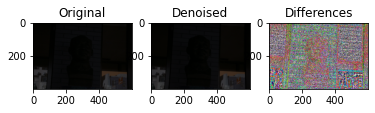

/content/lol_dataset/denoise_our485/684


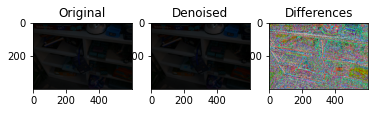

/content/lol_dataset/denoise_our485/743


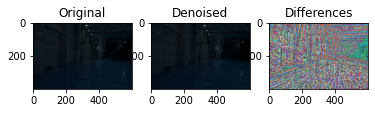

/content/lol_dataset/denoise_our485/238


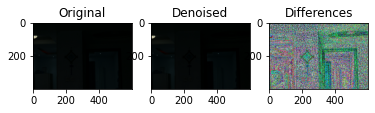

/content/lol_dataset/denoise_our485/771


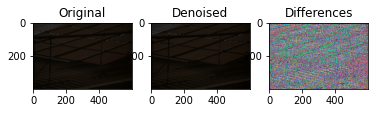

/content/lol_dataset/denoise_our485/702


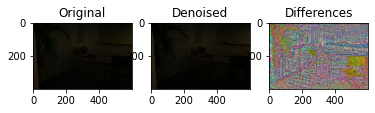

/content/lol_dataset/denoise_our485/661


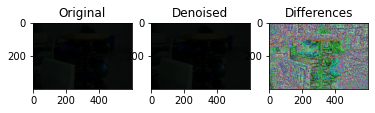

/content/lol_dataset/denoise_our485/508


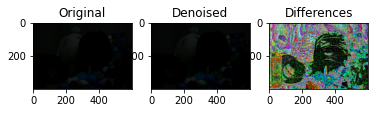

/content/lol_dataset/denoise_our485/639


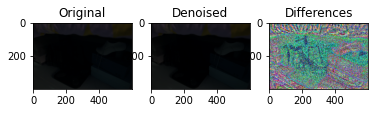

/content/lol_dataset/denoise_our485/160


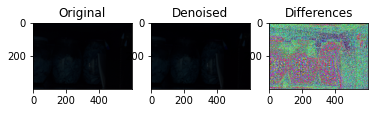

/content/lol_dataset/denoise_our485/87


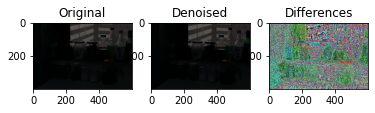

/content/lol_dataset/denoise_our485/613


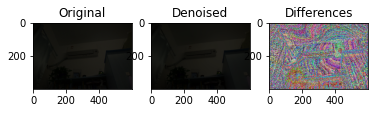

/content/lol_dataset/denoise_our485/159


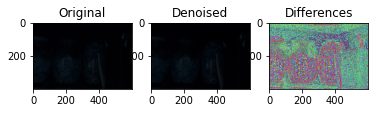

/content/lol_dataset/denoise_our485/88


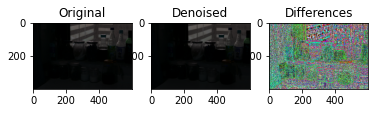

/content/lol_dataset/denoise_our485/515


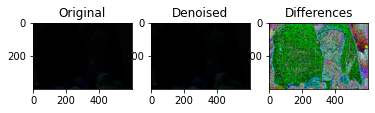

/content/lol_dataset/denoise_our485/615


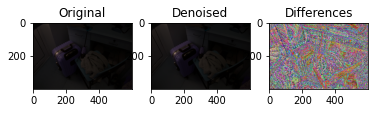

/content/lol_dataset/denoise_our485/736


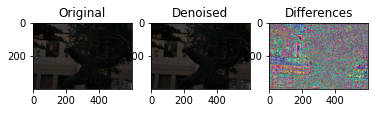

/content/lol_dataset/denoise_our485/671


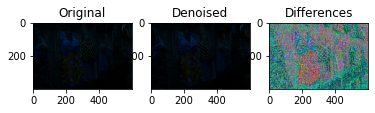

/content/lol_dataset/denoise_our485/558


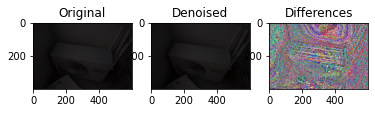

/content/lol_dataset/denoise_our485/485


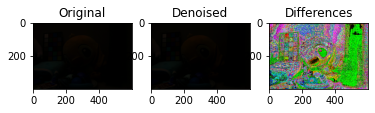

/content/lol_dataset/denoise_our485/162


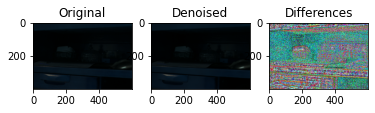

/content/lol_dataset/denoise_our485/230


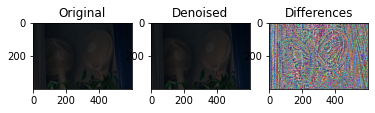

/content/lol_dataset/denoise_our485/183


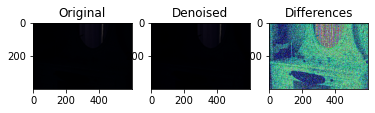

/content/lol_dataset/denoise_our485/93


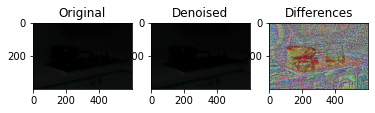

/content/lol_dataset/denoise_our485/573


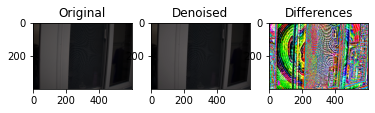

/content/lol_dataset/denoise_our485/522


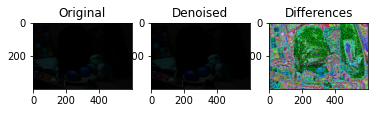

/content/lol_dataset/denoise_our485/128


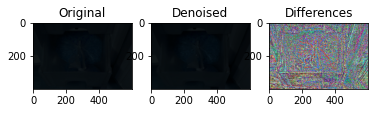

/content/lol_dataset/denoise_our485/630


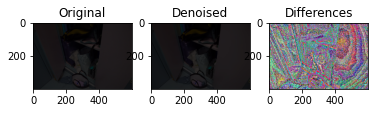

/content/lol_dataset/denoise_our485/552


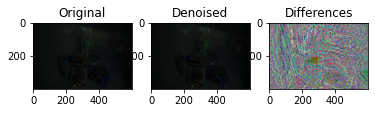

/content/lol_dataset/denoise_our485/683


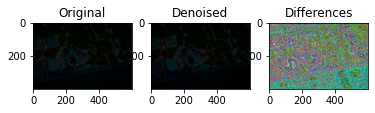

/content/lol_dataset/denoise_our485/173


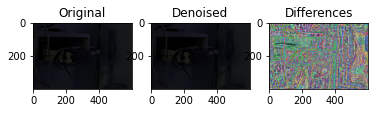

/content/lol_dataset/denoise_our485/204


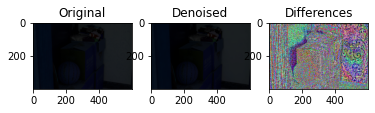

/content/lol_dataset/denoise_our485/235


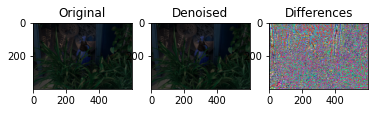

/content/lol_dataset/denoise_our485/38


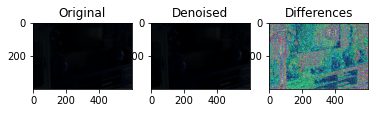

/content/lol_dataset/denoise_our485/186


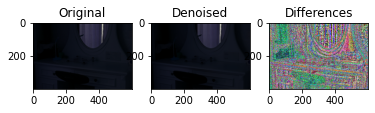

/content/lol_dataset/denoise_our485/789


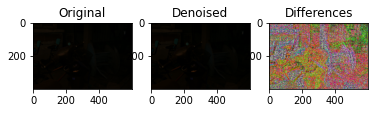

/content/lol_dataset/denoise_our485/142


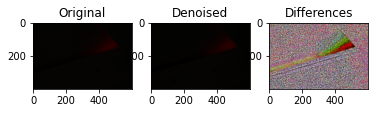

/content/lol_dataset/denoise_our485/236


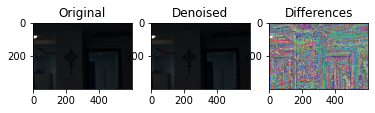

/content/lol_dataset/denoise_our485/653


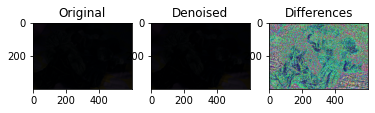

/content/lol_dataset/denoise_our485/215


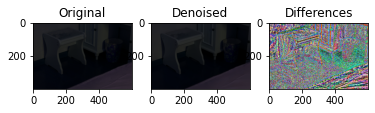

/content/lol_dataset/denoise_our485/646


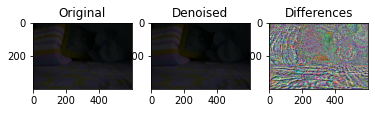

/content/lol_dataset/denoise_our485/610


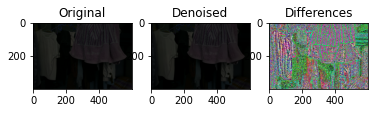

/content/lol_dataset/denoise_our485/722


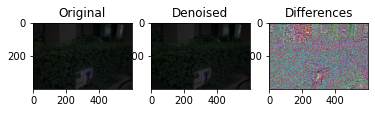

/content/lol_dataset/denoise_our485/735


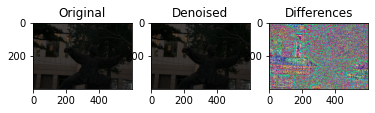

/content/lol_dataset/denoise_our485/263


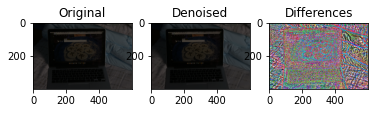

/content/lol_dataset/denoise_our485/78


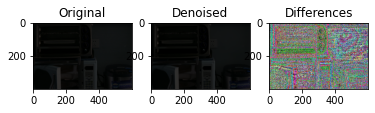

/content/lol_dataset/denoise_our485/201


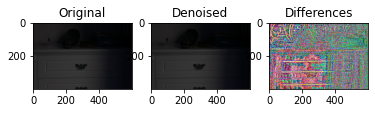

/content/lol_dataset/denoise_our485/640


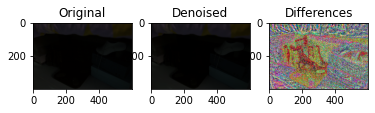

/content/lol_dataset/denoise_our485/328


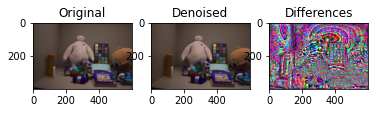

/content/lol_dataset/denoise_our485/86


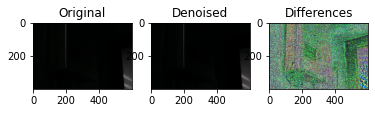

/content/lol_dataset/denoise_our485/471


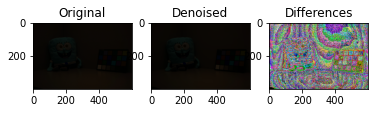

/content/lol_dataset/denoise_our485/715


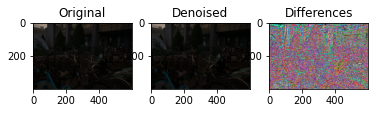

/content/lol_dataset/denoise_our485/27


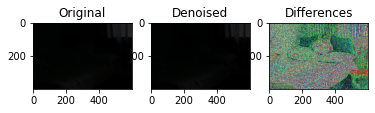

/content/lol_dataset/denoise_our485/239


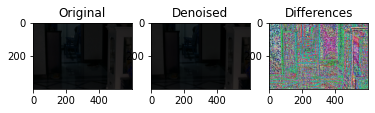

/content/lol_dataset/denoise_our485/118


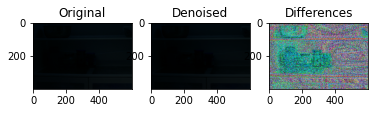

/content/lol_dataset/denoise_our485/464


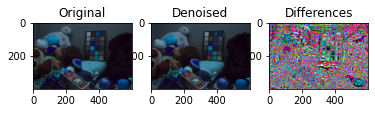

/content/lol_dataset/denoise_our485/623


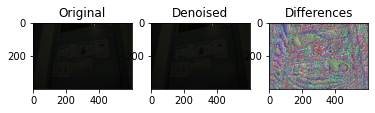

/content/lol_dataset/denoise_our485/696


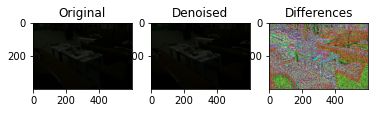

/content/lol_dataset/denoise_our485/538


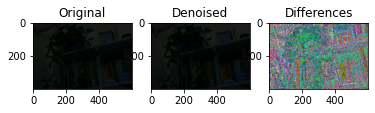

/content/lol_dataset/denoise_our485/548


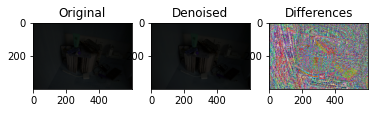

/content/lol_dataset/denoise_our485/121


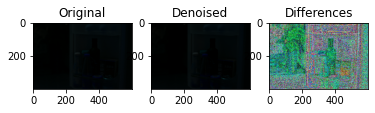

/content/lol_dataset/denoise_our485/264


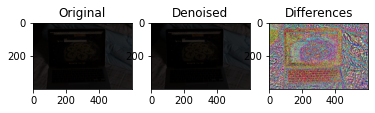

/content/lol_dataset/denoise_our485/559


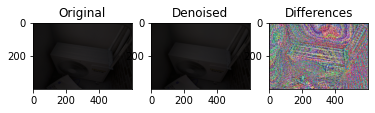

/content/lol_dataset/denoise_our485/135


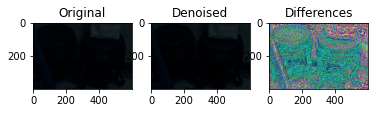

/content/lol_dataset/denoise_our485/200


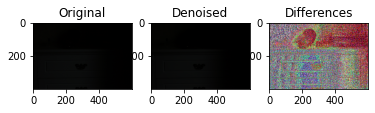

/content/lol_dataset/denoise_our485/180


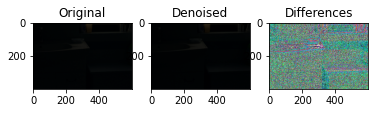

/content/lol_dataset/denoise_our485/685


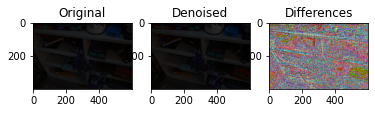

/content/lol_dataset/denoise_our485/662


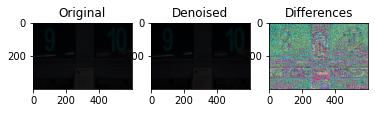

/content/lol_dataset/denoise_our485/91


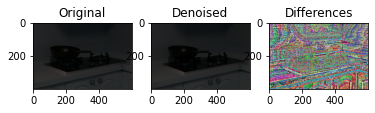

/content/lol_dataset/denoise_our485/527


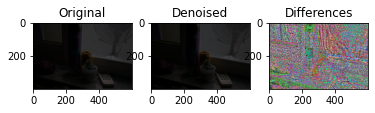

/content/lol_dataset/denoise_our485/57


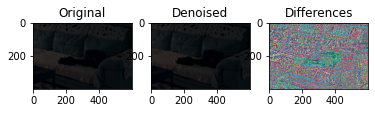

/content/lol_dataset/denoise_our485/597


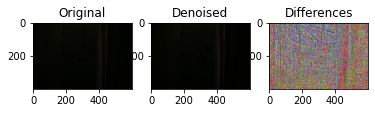

/content/lol_dataset/denoise_our485/94


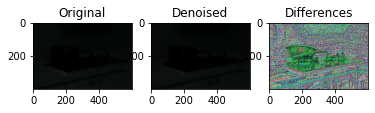

/content/lol_dataset/denoise_our485/587


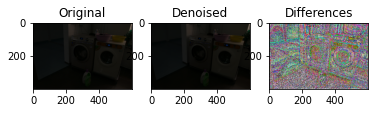

/content/lol_dataset/denoise_our485/176


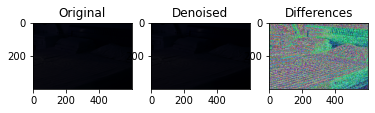

/content/lol_dataset/denoise_our485/574


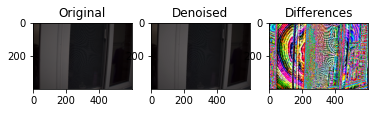

/content/lol_dataset/denoise_our485/738


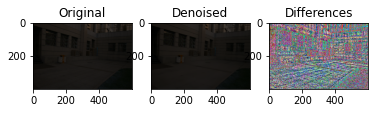

/content/lol_dataset/denoise_our485/249


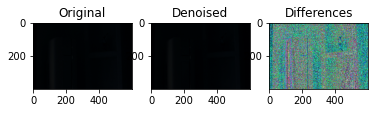

/content/lol_dataset/denoise_our485/775


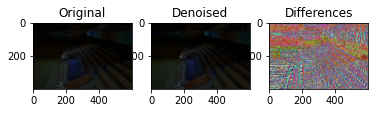

/content/lol_dataset/denoise_our485/74


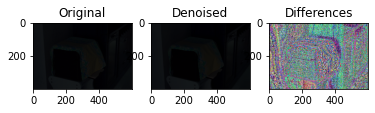

/content/lol_dataset/denoise_our485/125


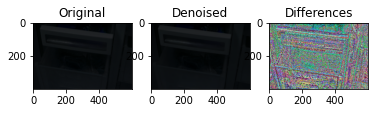

/content/lol_dataset/denoise_our485/113


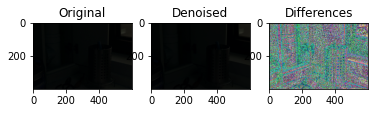

/content/lol_dataset/denoise_our485/106


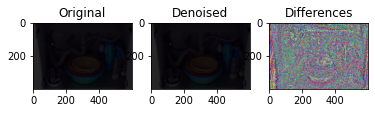

/content/lol_dataset/denoise_our485/132


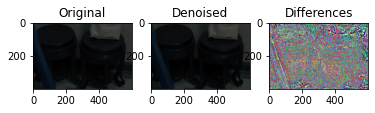

/content/lol_dataset/denoise_our485/202


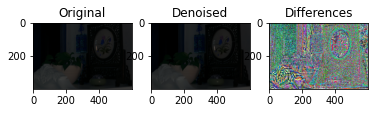

/content/lol_dataset/denoise_our485/751


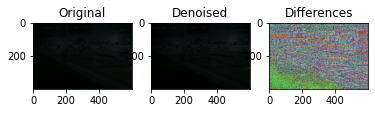

/content/lol_dataset/denoise_our485/193


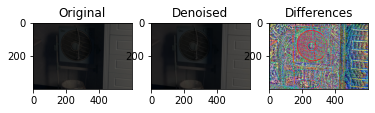

/content/lol_dataset/denoise_our485/189


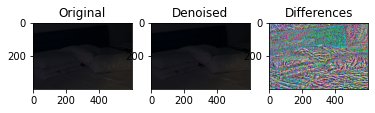

/content/lol_dataset/denoise_our485/648


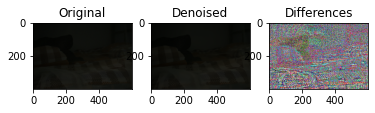

/content/lol_dataset/denoise_our485/262


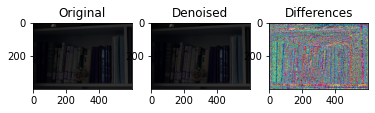

/content/lol_dataset/denoise_our485/772


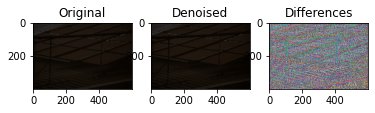

/content/lol_dataset/denoise_our485/494


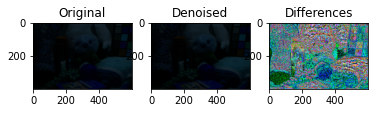

/content/lol_dataset/denoise_our485/564


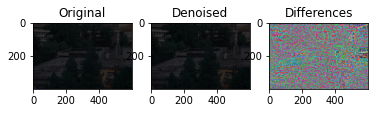

/content/lol_dataset/denoise_our485/207


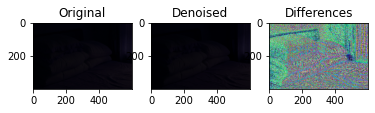

/content/lol_dataset/denoise_our485/668


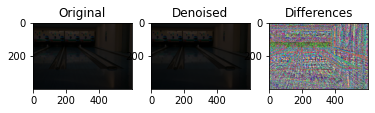

/content/lol_dataset/denoise_our485/247


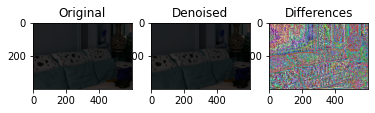

/content/lol_dataset/denoise_our485/470


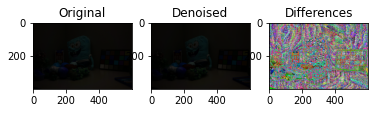

/content/lol_dataset/denoise_our485/502


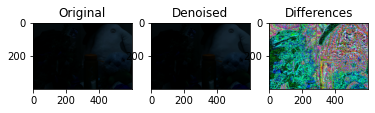

/content/lol_dataset/denoise_our485/523


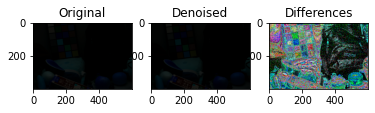

/content/lol_dataset/denoise_our485/718


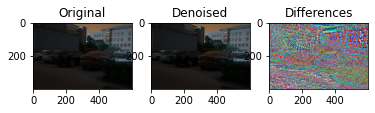

/content/lol_dataset/denoise_our485/699


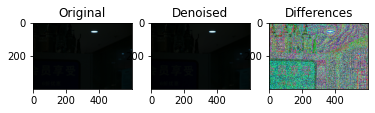

/content/lol_dataset/denoise_our485/5


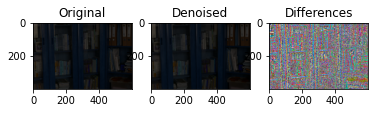

/content/lol_dataset/denoise_our485/68


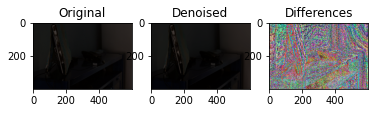

/content/lol_dataset/denoise_our485/241


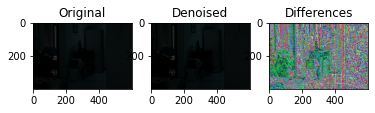

/content/lol_dataset/denoise_our485/750


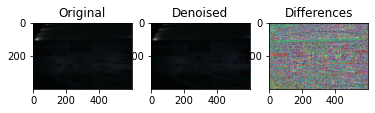

/content/lol_dataset/denoise_our485/9


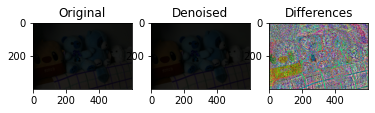

/content/lol_dataset/denoise_our485/107


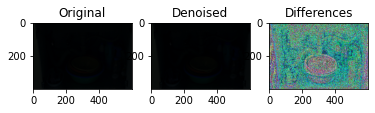

/content/lol_dataset/denoise_our485/500


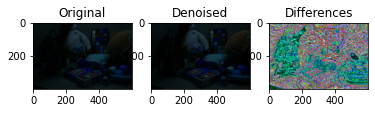

/content/lol_dataset/denoise_our485/660


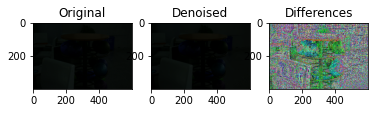

/content/lol_dataset/denoise_our485/60


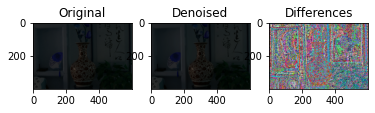

/content/lol_dataset/denoise_our485/625


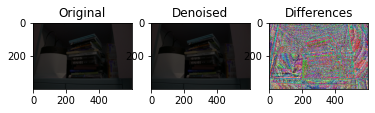

/content/lol_dataset/denoise_our485/732


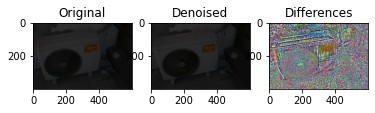

/content/lol_dataset/denoise_our485/126


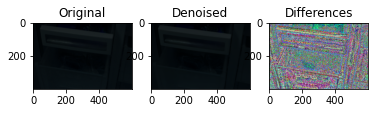

/content/lol_dataset/denoise_our485/82


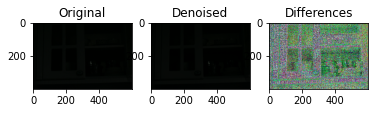

/content/lol_dataset/denoise_our485/56


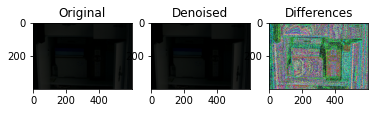

/content/lol_dataset/denoise_our485/606


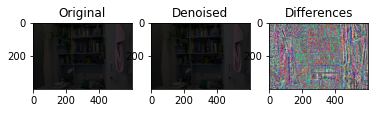

/content/lol_dataset/denoise_our485/237


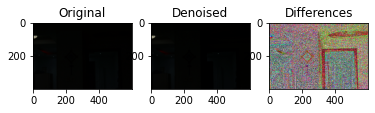

/content/lol_dataset/denoise_our485/626


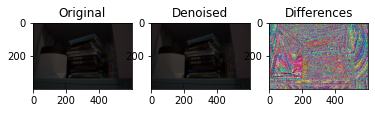

/content/lol_dataset/denoise_our485/124


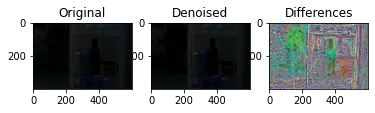

/content/lol_dataset/denoise_our485/762


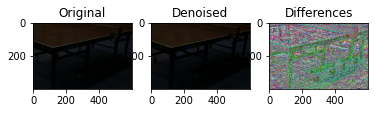

/content/lol_dataset/denoise_our485/131


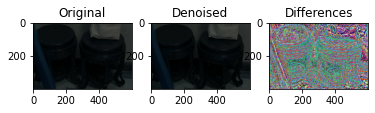

/content/lol_dataset/denoise_our485/59


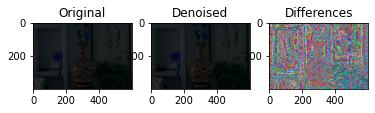

/content/lol_dataset/denoise_our485/698


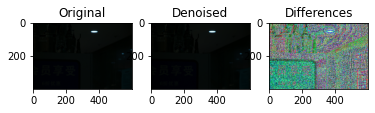

/content/lol_dataset/denoise_our485/554


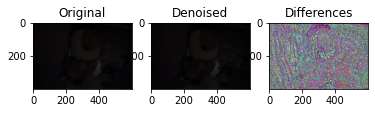

/content/lol_dataset/denoise_our485/36


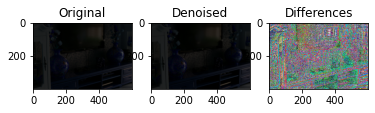

/content/lol_dataset/denoise_our485/89


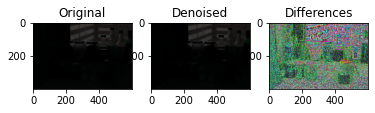

/content/lol_dataset/denoise_our485/265


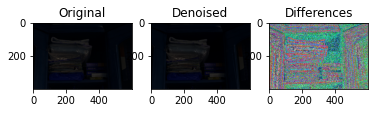

/content/lol_dataset/denoise_our485/617


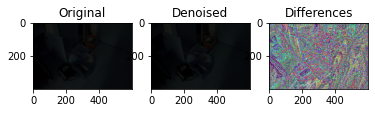

/content/lol_dataset/denoise_our485/561


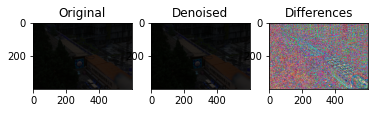

/content/lol_dataset/denoise_our485/692


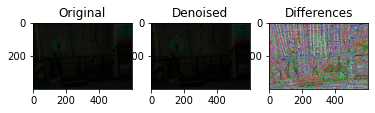

/content/lol_dataset/denoise_our485/760


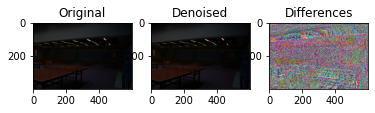

/content/lol_dataset/denoise_our485/48


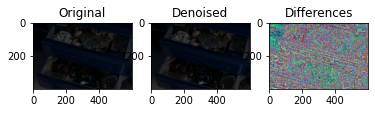

/content/lol_dataset/denoise_our485/213


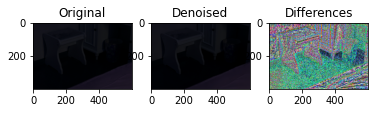

/content/lol_dataset/denoise_our485/555


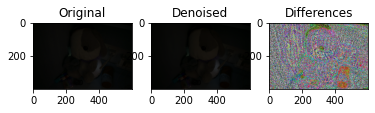

/content/lol_dataset/denoise_our485/726


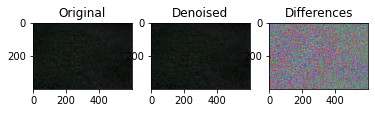

/content/lol_dataset/denoise_our485/592


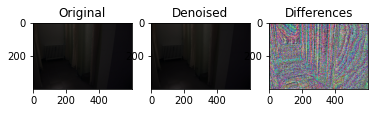

/content/lol_dataset/denoise_our485/44


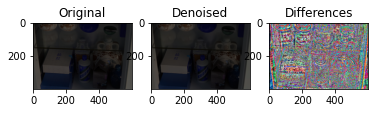

/content/lol_dataset/denoise_our485/225


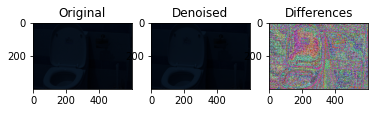

/content/lol_dataset/denoise_our485/681


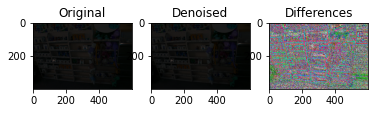

/content/lol_dataset/denoise_our485/137


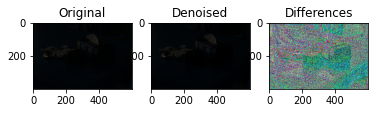

/content/lol_dataset/denoise_our485/487


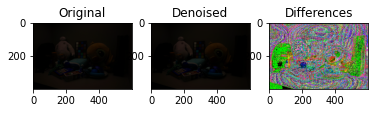

/content/lol_dataset/denoise_our485/152


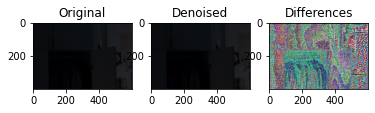

/content/lol_dataset/denoise_our485/766


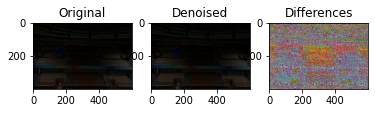

/content/lol_dataset/denoise_our485/556


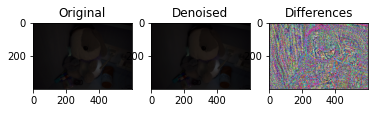

/content/lol_dataset/denoise_our485/127


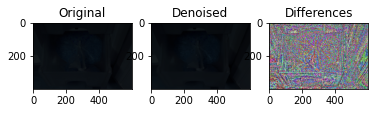

/content/lol_dataset/denoise_our485/545


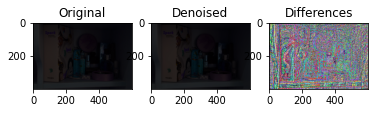

/content/lol_dataset/denoise_our485/746


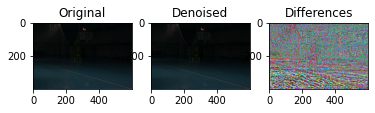

/content/lol_dataset/denoise_our485/489


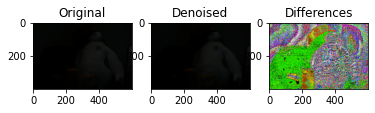

/content/lol_dataset/denoise_our485/507


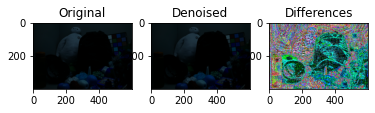

/content/lol_dataset/denoise_our485/579


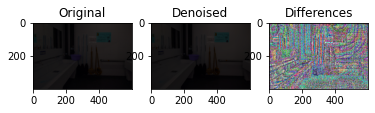

/content/lol_dataset/denoise_our485/69


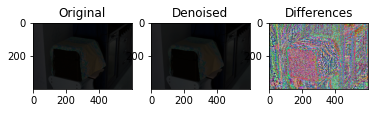

/content/lol_dataset/denoise_our485/187


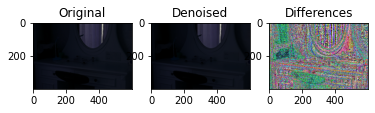

/content/lol_dataset/denoise_our485/770


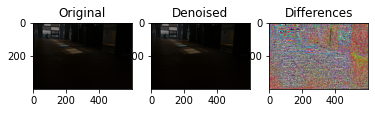

/content/lol_dataset/denoise_our485/141


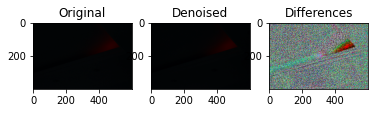

/content/lol_dataset/denoise_our485/261


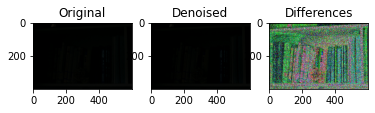

/content/lol_dataset/denoise_our485/97


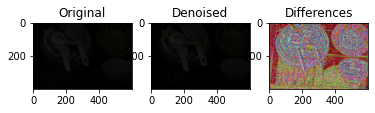

/content/lol_dataset/denoise_our485/596


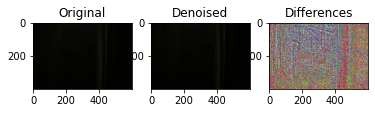

/content/lol_dataset/denoise_our485/719


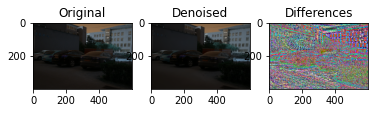

/content/lol_dataset/denoise_our485/730


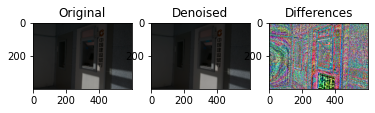

/content/lol_dataset/denoise_our485/221


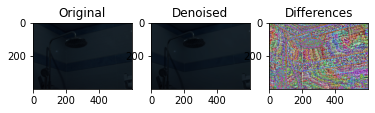

/content/lol_dataset/denoise_our485/98


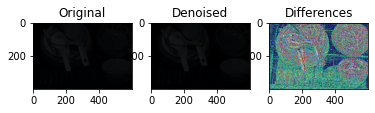

/content/lol_dataset/denoise_our485/571


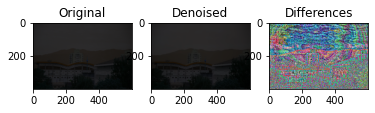

/content/lol_dataset/denoise_our485/244


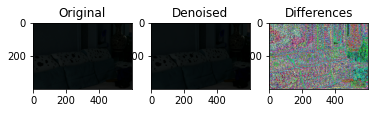

/content/lol_dataset/denoise_our485/260


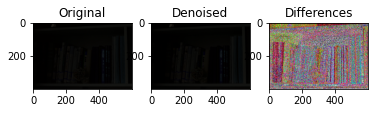

/content/lol_dataset/denoise_our485/704


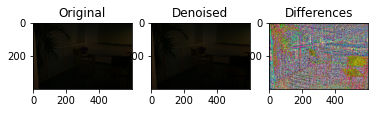

/content/lol_dataset/denoise_our485/784


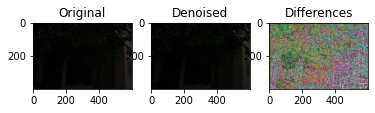

/content/lol_dataset/denoise_our485/171


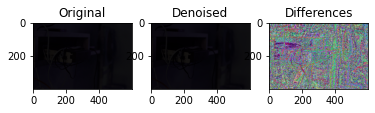

/content/lol_dataset/denoise_our485/28


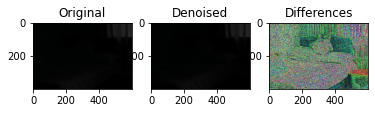

/content/lol_dataset/denoise_our485/70


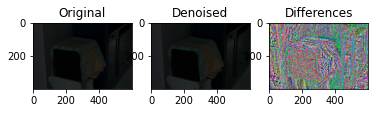

/content/lol_dataset/denoise_our485/779


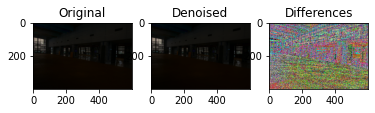

/content/lol_dataset/denoise_our485/233


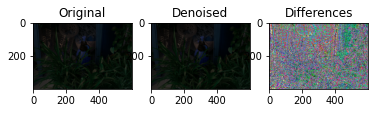

/content/lol_dataset/denoise_our485/723


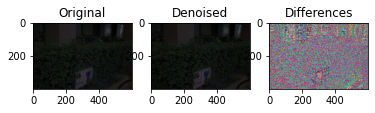

/content/lol_dataset/denoise_our485/138


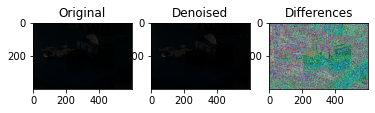

/content/lol_dataset/denoise_our485/585


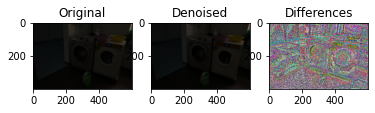

/content/lol_dataset/denoise_our485/76


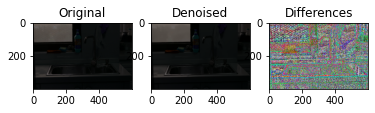

Image is empty!!
/content/lol_dataset/denoise_our485/588


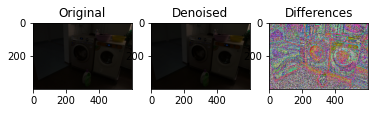

/content/lol_dataset/denoise_our485/110


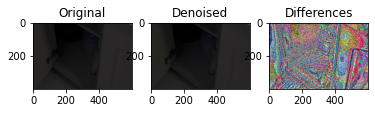

/content/lol_dataset/denoise_our485/473


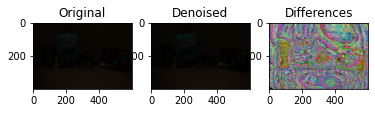

/content/lol_dataset/denoise_our485/149


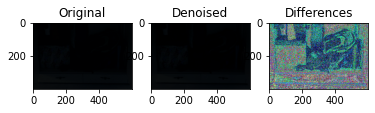

/content/lol_dataset/denoise_our485/16


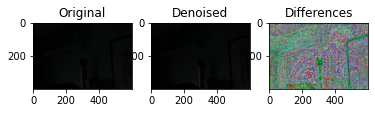

/content/lol_dataset/denoise_our485/651


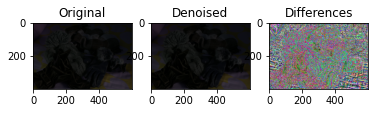

/content/lol_dataset/denoise_our485/511


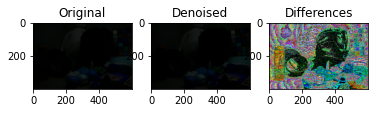

/content/lol_dataset/denoise_our485/677


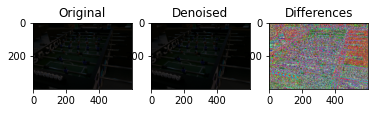

/content/lol_dataset/denoise_our485/203


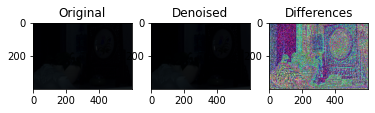

/content/lol_dataset/denoise_our485/174


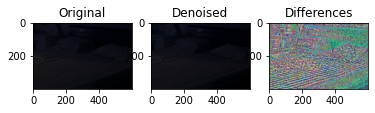

/content/lol_dataset/denoise_our485/116


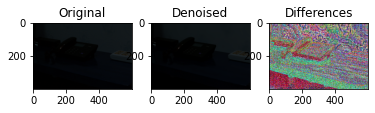

/content/lol_dataset/denoise_our485/129


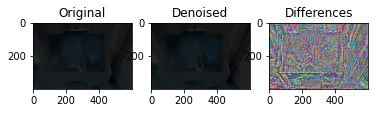

/content/lol_dataset/denoise_our485/678


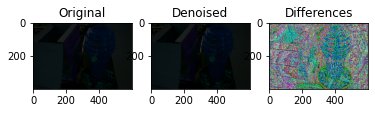

/content/lol_dataset/denoise_our485/254


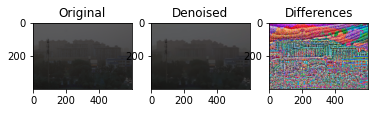

/content/lol_dataset/denoise_our485/566


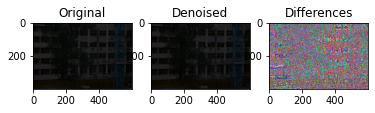

/content/lol_dataset/denoise_our485/670


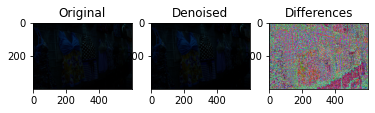

/content/lol_dataset/denoise_our485/2


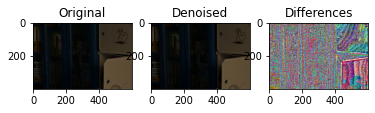

/content/lol_dataset/denoise_our485/658


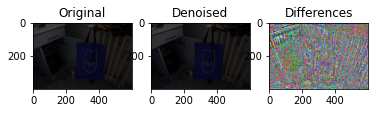

/content/lol_dataset/denoise_our485/741


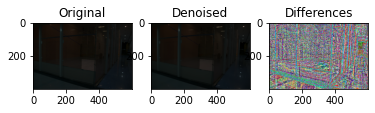

/content/lol_dataset/denoise_our485/539


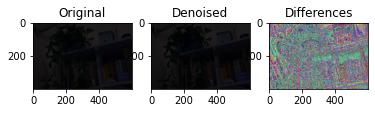

/content/lol_dataset/denoise_our485/614


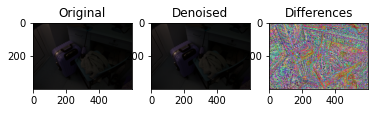

/content/lol_dataset/denoise_our485/689


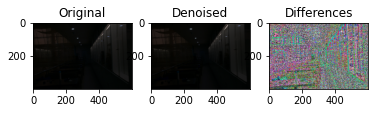

/content/lol_dataset/denoise_our485/697


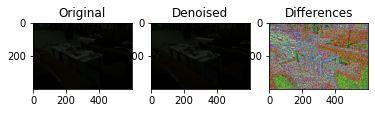

/content/lol_dataset/denoise_our485/586


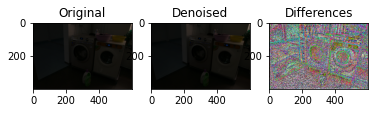

/content/lol_dataset/denoise_our485/504


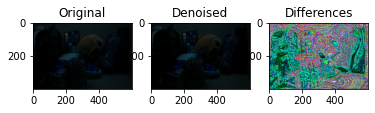

/content/lol_dataset/denoise_our485/550


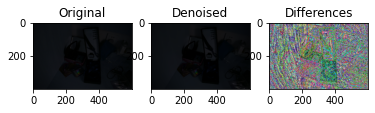

/content/lol_dataset/denoise_our485/52


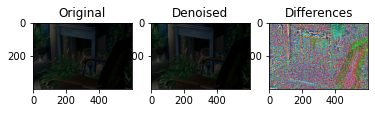

/content/lol_dataset/denoise_our485/752


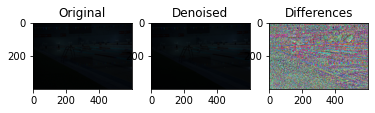

/content/lol_dataset/denoise_our485/608


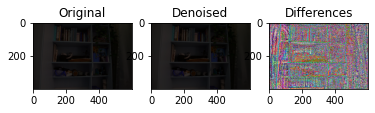

/content/lol_dataset/denoise_our485/591


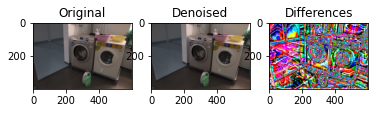

/content/lol_dataset/denoise_our485/12


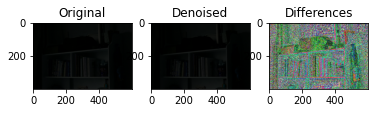

/content/lol_dataset/denoise_our485/774


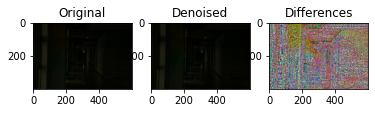

/content/lol_dataset/denoise_our485/641


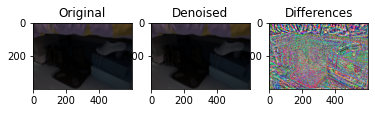

/content/lol_dataset/denoise_our485/242


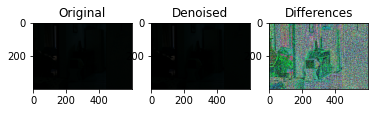

/content/lol_dataset/denoise_our485/63


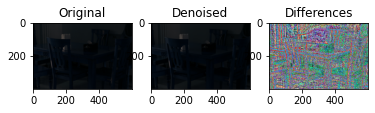

/content/lol_dataset/denoise_our485/578


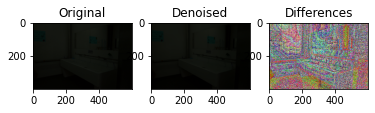

/content/lol_dataset/denoise_our485/744


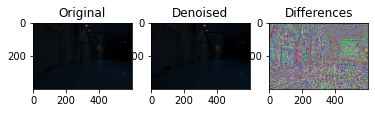

/content/lol_dataset/denoise_our485/196


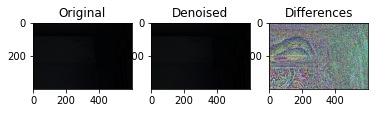

/content/lol_dataset/denoise_our485/484


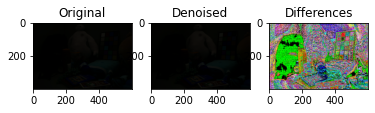

/content/lol_dataset/denoise_our485/216


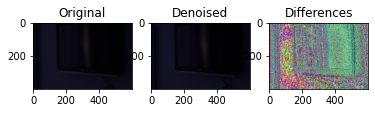

/content/lol_dataset/denoise_our485/211


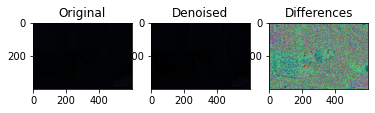

/content/lol_dataset/denoise_our485/616


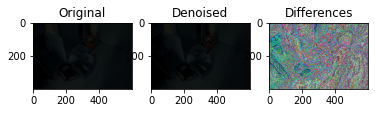

/content/lol_dataset/denoise_our485/674


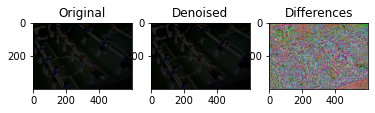

/content/lol_dataset/denoise_our485/505


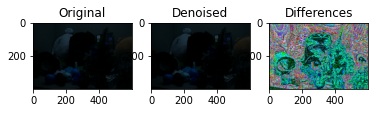

/content/lol_dataset/denoise_our485/250


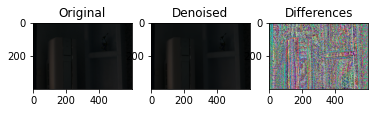

/content/lol_dataset/denoise_our485/570


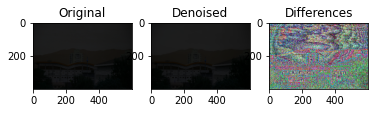

/content/lol_dataset/denoise_our485/248


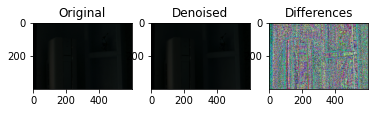

/content/lol_dataset/denoise_our485/691


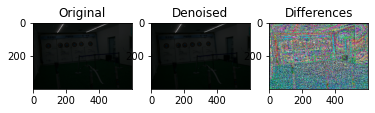

/content/lol_dataset/denoise_our485/73


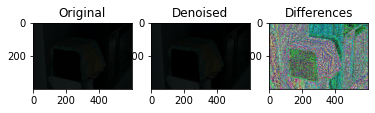

/content/lol_dataset/denoise_our485/580


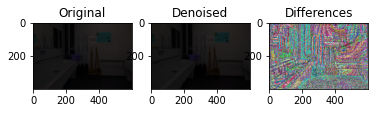

/content/lol_dataset/denoise_our485/488


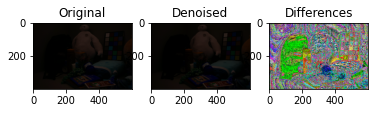

/content/lol_dataset/denoise_our485/694


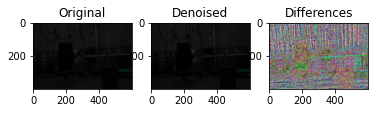

/content/lol_dataset/denoise_our485/576


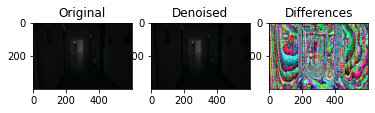

/content/lol_dataset/denoise_our485/469


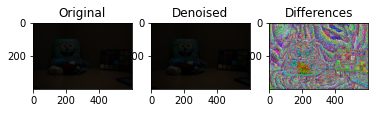

/content/lol_dataset/denoise_our485/43


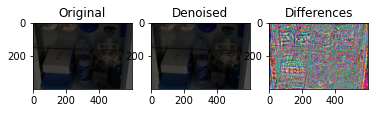

/content/lol_dataset/denoise_our485/525


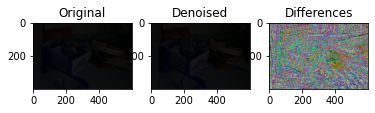

/content/lol_dataset/denoise_our485/140


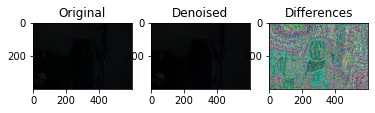

/content/lol_dataset/denoise_our485/46


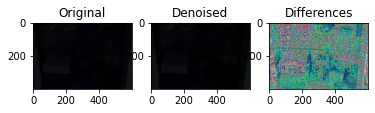

/content/lol_dataset/denoise_our485/342


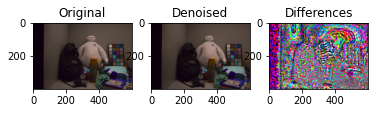

/content/lol_dataset/denoise_our485/645


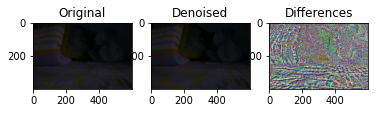

/content/lol_dataset/denoise_our485/727


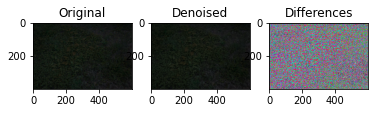

/content/lol_dataset/denoise_our485/206


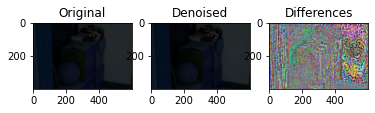

/content/lol_dataset/denoise_our485/240


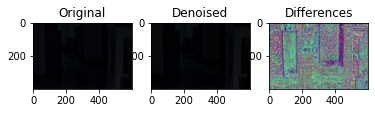

/content/lol_dataset/denoise_our485/634


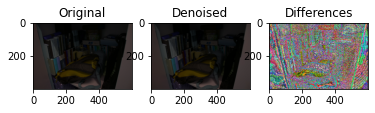

/content/lol_dataset/denoise_our485/258


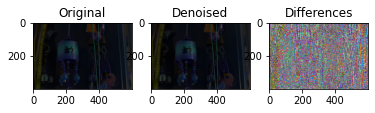

/content/lol_dataset/denoise_our485/195


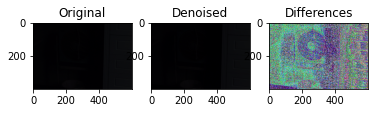

/content/lol_dataset/denoise_our485/667


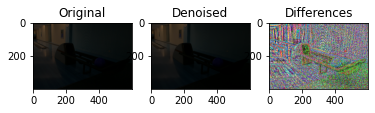

/content/lol_dataset/denoise_our485/763


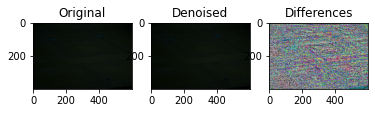

/content/lol_dataset/denoise_our485/562


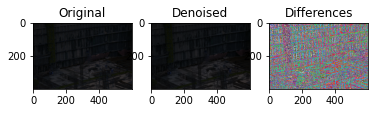

/content/lol_dataset/denoise_our485/499


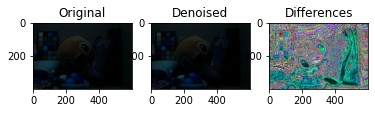

/content/lol_dataset/denoise_our485/563


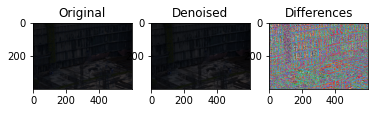

/content/lol_dataset/denoise_our485/557


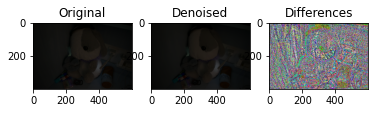

/content/lol_dataset/denoise_our485/199


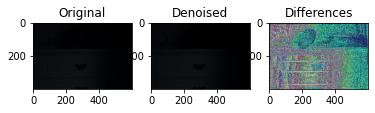

/content/lol_dataset/denoise_our485/572


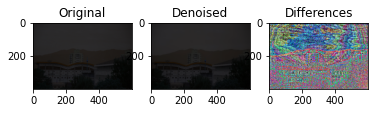

/content/lol_dataset/denoise_our485/733


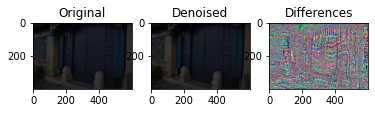

/content/lol_dataset/denoise_our485/643


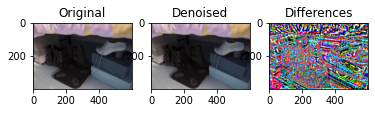

/content/lol_dataset/denoise_our485/62


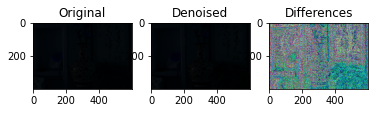

/content/lol_dataset/denoise_our485/642


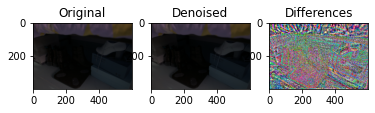

/content/lol_dataset/denoise_our485/143


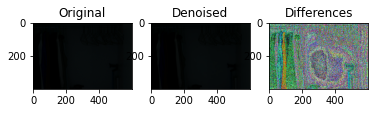

/content/lol_dataset/denoise_our485/711


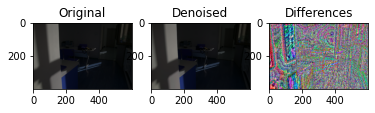

/content/lol_dataset/denoise_our485/102


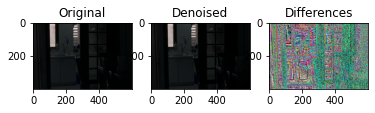

/content/lol_dataset/denoise_our485/252


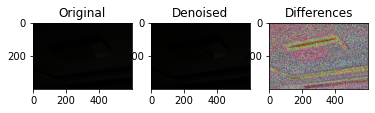

/content/lol_dataset/denoise_our485/731


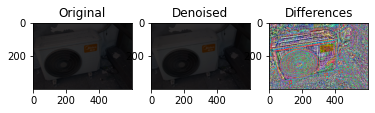

/content/lol_dataset/denoise_our485/708


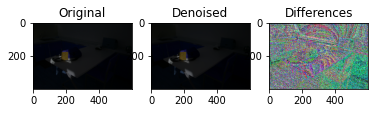

/content/lol_dataset/denoise_our485/210


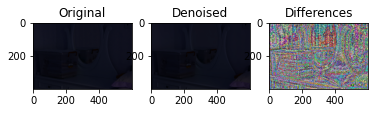

/content/lol_dataset/denoise_our485/232


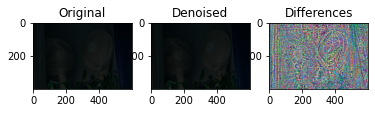

/content/lol_dataset/denoise_our485/544


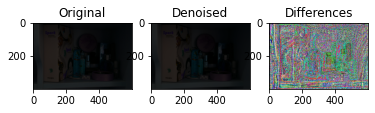

/content/lol_dataset/denoise_our485/50


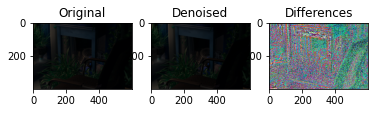

/content/lol_dataset/denoise_our485/605


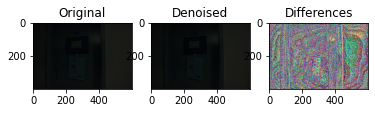

/content/lol_dataset/denoise_our485/13


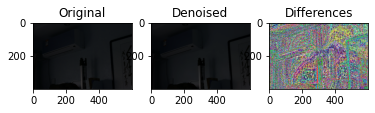

/content/lol_dataset/denoise_our485/734


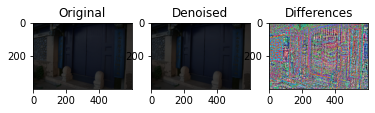

/content/lol_dataset/denoise_our485/257


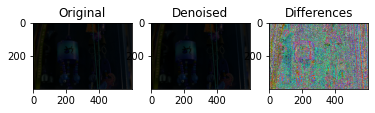

/content/lol_dataset/denoise_our485/713


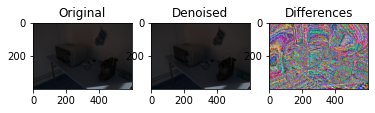

done


In [6]:
import cv2 as cv
from glob import glob
%pylab inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from os import listdir

path = "/content/lol_dataset/our485/low/"
files = listdir(path)
# declare valid filtypes
valid_image_extensions = [".jpg", ".jpeg", ".png", ".tif", ".tiff"]
new_folder = "/content/lol_dataset/denoise_our485/"


for name in files:
  
            # check if it is a valid filetype
  filename, file_extension = os.path.splitext(name)
  #print(filename)
  if file_extension in valid_image_extensions:
    # create a folder for this image
    new_path = new_folder+filename
    print(new_path)
    if not os.path.exists(path):
      os.makedirs(path)
  
  # load image in grayscale
  img = cv.imread(path+name, 1)
  
  if img is None:
        print("Image is empty!!")
        pass
  else:
        #print("Image is not empty!!")
        #print("Shape of image ", img.shape)
        converted_img = cv.cvtColor(img, cv.COLOR_BGR2RGB)

        dst = cv.fastNlMeansDenoisingColored(converted_img,None,3,3,7,21)

        converted_dst = cv.cvtColor(dst, cv.COLOR_RGB2BGR)

        diff = converted_dst - img

        plt.subplot(131), plt.imshow(img), plt.title('Original')
        plt.subplot(132), plt.imshow(converted_dst), plt.title('Denoised')
        plt.subplot(133), plt.imshow(diff), plt.title('Differences')
        plt.show()
        cv.imwrite(new_path+".png", converted_dst)
print('done')
                  



In [7]:
import os.path
from os import path

if path.exists('/content/lol_dataset/denoise_eval15') == False:
  os.mkdir('/content/lol_dataset/denoise_eval15')

os.chdir('/content/lol_dataset/denoise_eval15')

/content/lol_dataset/denoise_eval15/669


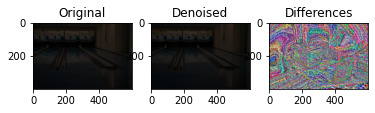

/content/lol_dataset/denoise_eval15/748


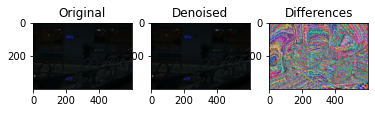

/content/lol_dataset/denoise_eval15/547


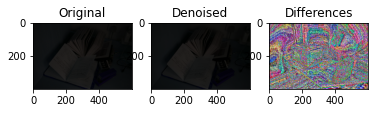

/content/lol_dataset/denoise_eval15/111


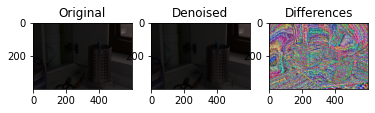

/content/lol_dataset/denoise_eval15/179


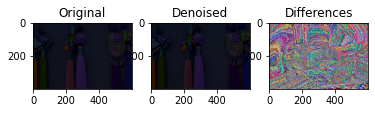

/content/lol_dataset/denoise_eval15/780


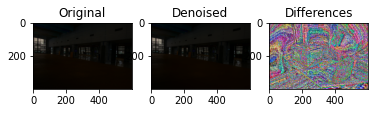

/content/lol_dataset/denoise_eval15/79


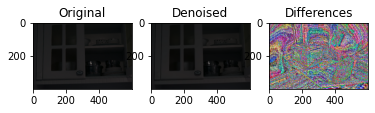

/content/lol_dataset/denoise_eval15/778


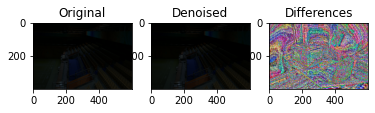

/content/lol_dataset/denoise_eval15/493


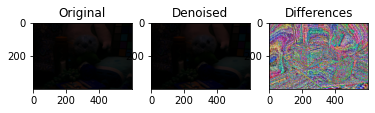

/content/lol_dataset/denoise_eval15/22


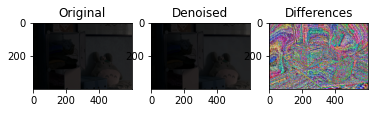

/content/lol_dataset/denoise_eval15/665


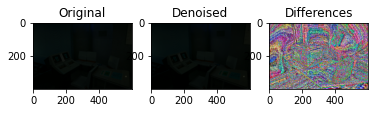

/content/lol_dataset/denoise_eval15/1


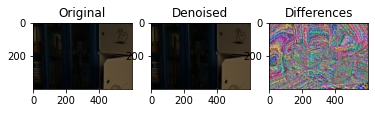

/content/lol_dataset/denoise_eval15/146


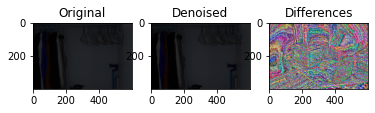

/content/lol_dataset/denoise_eval15/23


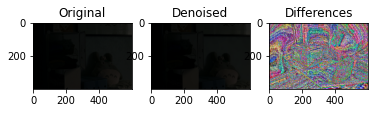

/content/lol_dataset/denoise_eval15/55


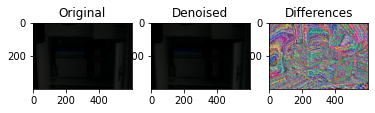

done


In [8]:
path = "/content/lol_dataset/eval15/low/"
files = listdir(path)
# declare valid filtypes
valid_image_extensions = [".jpg", ".jpeg", ".png", ".tif", ".tiff"]
new_folder = "/content/lol_dataset/denoise_eval15/"


for name in files:
  
            # check if it is a valid filetype
  filename, file_extension = os.path.splitext(name)
  #print(filename)
  if file_extension in valid_image_extensions:
    # create a folder for this image
    new_path = new_folder+filename
    print(new_path)
    if not os.path.exists(path):
      os.makedirs(path)
  
  # load image in grayscale
  img = cv.imread(path+name, 1)
  
  if img is None:
        print("Image is empty!!")
        pass
  else:
        #print("Image is not empty!!")
        #print("Shape of image ", img.shape)
        converted_img = cv.cvtColor(img, cv.COLOR_BGR2RGB)

        dst = cv.fastNlMeansDenoisingColored(converted_img,None,3,3,7,21)

        converted_dst = cv.cvtColor(dst, cv.COLOR_RGB2BGR)

        plt.subplot(131), plt.imshow(img), plt.title('Original')
        plt.subplot(132), plt.imshow(converted_dst), plt.title('Denoised')
        plt.subplot(133), plt.imshow(diff), plt.title('Differences')
        plt.show()
        
        cv.imwrite(new_path+".png", converted_dst)
print('done')

In [9]:
train_low_light_images = sorted(glob("/content/lol_dataset/denoise_our485/*"))[:MAX_TRAIN_IMAGES]
val_low_light_images = sorted(glob("/content/lol_dataset/denoise_our485/*"))[MAX_TRAIN_IMAGES:]

train_dataset = data_generator(train_low_light_images)
val_dataset = data_generator(val_low_light_images)
test_low_light_images = sorted(glob("/content/lol_dataset/denoise_eval15/*"))

print("Train Dataset:", train_dataset)
print("Validation Dataset:", val_dataset)

Train Dataset: <BatchDataset element_spec=TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None)>
Validation Dataset: <BatchDataset element_spec=TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None)>


In [10]:
def build_dce_net():
    input_img = keras.Input(shape=[None, None, 3])
    conv1 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(input_img)
    conv2 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(conv1)
    conv3 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(conv2)
    conv4 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(conv3)
    int_con1 = layers.Concatenate(axis=-1)([conv4, conv3])
    conv5 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(int_con1)
    int_con2 = layers.Concatenate(axis=-1)([conv5, conv2])
    conv6 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(int_con2)
    int_con3 = layers.Concatenate(axis=-1)([conv6, conv1])
    x_r = layers.Conv2D(24, (3, 3), strides=(1, 1), activation="tanh", padding="same")(
        int_con3
    )
    return keras.Model(inputs=input_img, outputs=x_r)

In [11]:
def color_constancy_loss(x):
    mean_rgb = tf.reduce_mean(x, axis=(1, 2), keepdims=True)
    mr, mg, mb = mean_rgb[:, :, :, 0], mean_rgb[:, :, :, 1], mean_rgb[:, :, :, 2]
    d_rg = tf.square(mr - mg)
    d_rb = tf.square(mr - mb)
    d_gb = tf.square(mb - mg)
    return tf.sqrt(tf.square(d_rg) + tf.square(d_rb) + tf.square(d_gb))

In [12]:
def exposure_loss(x, mean_val=0.6):
    x = tf.reduce_mean(x, axis=3, keepdims=True)
    mean = tf.nn.avg_pool2d(x, ksize=16, strides=16, padding="VALID")
    return tf.reduce_mean(tf.square(mean - mean_val))

In [13]:
def illumination_smoothness_loss(x):
    batch_size = tf.shape(x)[0]
    h_x = tf.shape(x)[1]
    w_x = tf.shape(x)[2]
    count_h = (tf.shape(x)[2] - 1) * tf.shape(x)[3]
    count_w = tf.shape(x)[2] * (tf.shape(x)[3] - 1)
    h_tv = tf.reduce_sum(tf.square((x[:, 1:, :, :] - x[:, : h_x - 1, :, :])))
    w_tv = tf.reduce_sum(tf.square((x[:, :, 1:, :] - x[:, :, : w_x - 1, :])))
    batch_size = tf.cast(batch_size, dtype=tf.float32)
    count_h = tf.cast(count_h, dtype=tf.float32)
    count_w = tf.cast(count_w, dtype=tf.float32)
    return 2 * (h_tv / count_h + w_tv / count_w) / batch_size

In [14]:
class SpatialConsistencyLoss(keras.losses.Loss):
    def __init__(self, **kwargs):
        super(SpatialConsistencyLoss, self).__init__(reduction="none")

        self.left_kernel = tf.constant(
            [[[[0, 0, 0]], [[-1, 1, 0]], [[0, 0, 0]]]], dtype=tf.float32
        )
        self.right_kernel = tf.constant(
            [[[[0, 0, 0]], [[0, 1, -1]], [[0, 0, 0]]]], dtype=tf.float32
        )
        self.up_kernel = tf.constant(
            [[[[0, -1, 0]], [[0, 1, 0]], [[0, 0, 0]]]], dtype=tf.float32
        )
        self.down_kernel = tf.constant(
            [[[[0, 0, 0]], [[0, 1, 0]], [[0, -1, 0]]]], dtype=tf.float32
        )

    def call(self, y_true, y_pred):

        original_mean = tf.reduce_mean(y_true, 3, keepdims=True)
        enhanced_mean = tf.reduce_mean(y_pred, 3, keepdims=True)
        original_pool = tf.nn.avg_pool2d(
            original_mean, ksize=4, strides=4, padding="VALID"
        )
        enhanced_pool = tf.nn.avg_pool2d(
            enhanced_mean, ksize=4, strides=4, padding="VALID"
        )

        d_original_left = tf.nn.conv2d(
            original_pool, self.left_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_original_right = tf.nn.conv2d(
            original_pool, self.right_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_original_up = tf.nn.conv2d(
            original_pool, self.up_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_original_down = tf.nn.conv2d(
            original_pool, self.down_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )

        d_enhanced_left = tf.nn.conv2d(
            enhanced_pool, self.left_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_enhanced_right = tf.nn.conv2d(
            enhanced_pool, self.right_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_enhanced_up = tf.nn.conv2d(
            enhanced_pool, self.up_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_enhanced_down = tf.nn.conv2d(
            enhanced_pool, self.down_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )

        d_left = tf.square(d_original_left - d_enhanced_left)
        d_right = tf.square(d_original_right - d_enhanced_right)
        d_up = tf.square(d_original_up - d_enhanced_up)
        d_down = tf.square(d_original_down - d_enhanced_down)
        return d_left + d_right + d_up + d_down

In [15]:
class ZeroDCE(keras.Model):
    def __init__(self, **kwargs):
        super(ZeroDCE, self).__init__(**kwargs)
        self.dce_model = build_dce_net()

    def compile(self, learning_rate, **kwargs):
        super(ZeroDCE, self).compile(**kwargs)
        self.optimizer = keras.optimizers.Adam(learning_rate=learning_rate)
        self.spatial_constancy_loss = SpatialConsistencyLoss(reduction="none")

    def get_enhanced_image(self, data, output):
        r1 = output[:, :, :, :3]
        r2 = output[:, :, :, 3:6]
        r3 = output[:, :, :, 6:9]
        r4 = output[:, :, :, 9:12]
        r5 = output[:, :, :, 12:15]
        r6 = output[:, :, :, 15:18]
        r7 = output[:, :, :, 18:21]
        r8 = output[:, :, :, 21:24]
        x = data + r1 * (tf.square(data) - data)
        x = x + r2 * (tf.square(x) - x)
        x = x + r3 * (tf.square(x) - x)
        enhanced_image = x + r4 * (tf.square(x) - x)
        x = enhanced_image + r5 * (tf.square(enhanced_image) - enhanced_image)
        x = x + r6 * (tf.square(x) - x)
        x = x + r7 * (tf.square(x) - x)
        enhanced_image = x + r8 * (tf.square(x) - x)
        return enhanced_image

    def call(self, data):
        dce_net_output = self.dce_model(data)
        return self.get_enhanced_image(data, dce_net_output)

    def compute_losses(self, data, output):
        enhanced_image = self.get_enhanced_image(data, output)
        loss_illumination = 200 * illumination_smoothness_loss(output)
        loss_spatial_constancy = tf.reduce_mean(
            self.spatial_constancy_loss(enhanced_image, data)
        )
        loss_color_constancy = 5 * tf.reduce_mean(color_constancy_loss(enhanced_image))
        loss_exposure = 10 * tf.reduce_mean(exposure_loss(enhanced_image))
        total_loss = (
            loss_illumination
            + loss_spatial_constancy
            + loss_color_constancy
            + loss_exposure
        )
        return {
            "total_loss": total_loss,
            "illumination_smoothness_loss": loss_illumination,
            "spatial_constancy_loss": loss_spatial_constancy,
            "color_constancy_loss": loss_color_constancy,
            "exposure_loss": loss_exposure,
        }

    def train_step(self, data):
        with tf.GradientTape() as tape:
            output = self.dce_model(data)
            losses = self.compute_losses(data, output)
        gradients = tape.gradient(
            losses["total_loss"], self.dce_model.trainable_weights
        )
        self.optimizer.apply_gradients(zip(gradients, self.dce_model.trainable_weights))
        return losses

    def test_step(self, data):
        output = self.dce_model(data)
        return self.compute_losses(data, output)

    def save_weights(self, filepath, overwrite=True, save_format=None, options=None):
        """While saving the weights, we simply save the weights of the DCE-Net"""
        self.dce_model.save_weights(
            filepath, overwrite=overwrite, save_format=save_format, options=options
        )

    def load_weights(self, filepath, by_name=False, skip_mismatch=False, options=None):
        """While loading the weights, we simply load the weights of the DCE-Net"""
        self.dce_model.load_weights(
            filepath=filepath,
            by_name=by_name,
            skip_mismatch=skip_mismatch,
            options=options,
        )

Epoch 1/100
25/25 [==============================] - 18s 302ms/step - total_loss: 5.3511 - illumination_smoothness_loss: 2.3865 - spatial_constancy_loss: 3.8290e-06 - color_constancy_loss: 0.0024 - exposure_loss: 2.9622 - val_total_loss: 4.4899 - val_illumination_smoothness_loss: 1.4596 - val_spatial_constancy_loss: 3.7139e-06 - val_color_constancy_loss: 3.6506e-04 - val_exposure_loss: 3.0299
Epoch 2/100
25/25 [==============================] - 7s 285ms/step - total_loss: 4.4296 - illumination_smoothness_loss: 1.4799 - spatial_constancy_loss: 1.1759e-05 - color_constancy_loss: 0.0025 - exposure_loss: 2.9472 - val_total_loss: 3.9443 - val_illumination_smoothness_loss: 0.9255 - val_spatial_constancy_loss: 1.6583e-05 - val_color_constancy_loss: 3.5512e-04 - val_exposure_loss: 3.0184
Epoch 3/100
25/25 [==============================] - 7s 292ms/step - total_loss: 3.9897 - illumination_smoothness_loss: 1.0522 - spatial_constancy_loss: 3.0585e-05 - color_constancy_loss: 0.0026 - exposure_los

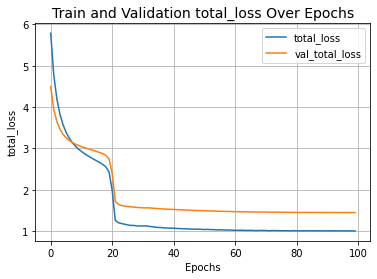

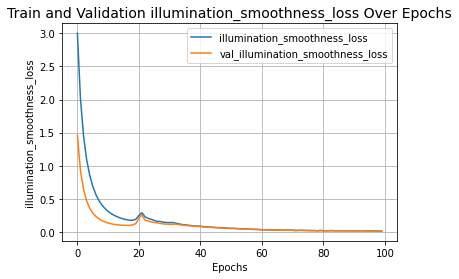

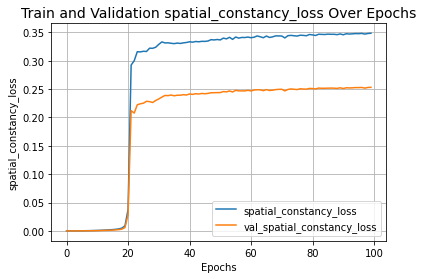

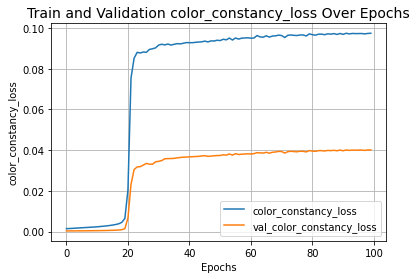

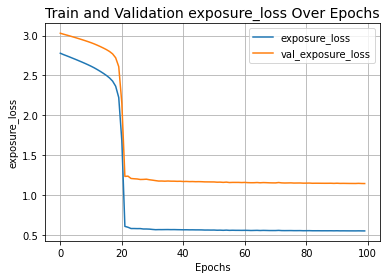

In [16]:
zero_dce_model = ZeroDCE()
zero_dce_model.compile(learning_rate=1e-4)
history = zero_dce_model.fit(train_dataset, validation_data=val_dataset, epochs=100)
zero_dce_model.save_weights('/content/lol_dataset/')

def plot_result(item):
    plt.plot(history.history[item], label=item)
    plt.plot(history.history["val_" + item], label="val_" + item)
    plt.xlabel("Epochs")
    plt.ylabel(item)
    plt.title("Train and Validation {} Over Epochs".format(item), fontsize=14)
    plt.legend()
    plt.grid()
    plt.show()


plot_result("total_loss")
plot_result("illumination_smoothness_loss")
plot_result("spatial_constancy_loss")
plot_result("color_constancy_loss")
plot_result("exposure_loss")

In [17]:
def plot_results(images, titles, figure_size=(12, 12)):
    fig = plt.figure(figsize=figure_size)
    for i in range(len(images)):
        fig.add_subplot(1, len(images), i + 1).set_title(titles[i])
        _ = plt.imshow(images[i])
        plt.axis("off")
    plt.show()


def infer(original_image):
    image = keras.preprocessing.image.img_to_array(original_image)
    image = image.astype("float32") / 255.0
    image = np.expand_dims(image, axis=0)
    output_image = zero_dce_model(image)
    output_image = tf.cast((output_image[0, :, :, :] * 255), dtype=np.uint8)
    output_image = Image.fromarray(output_image.numpy())
    return output_image

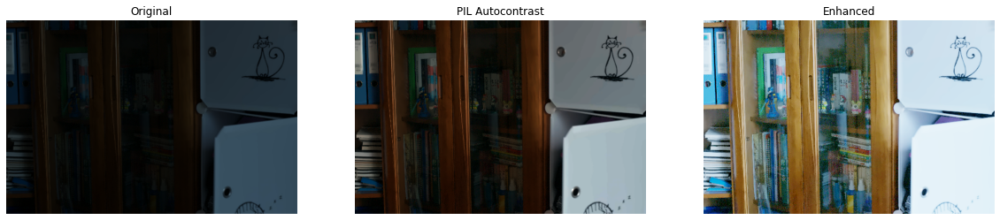

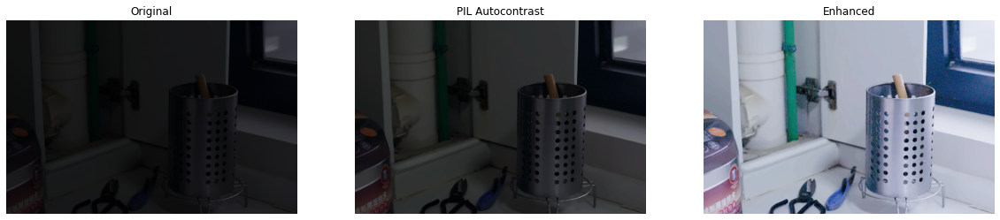

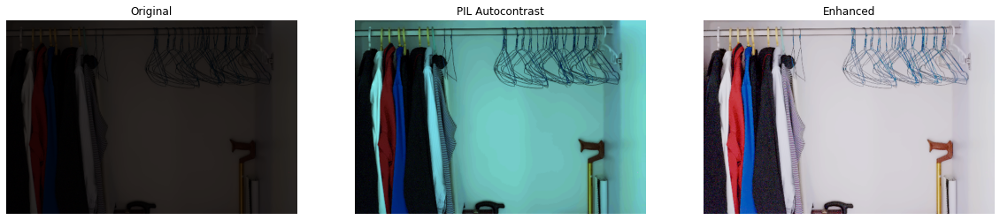

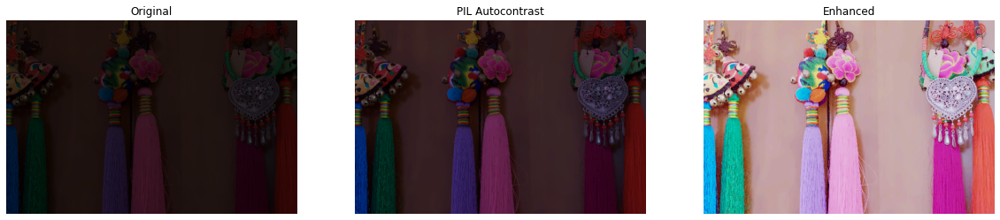

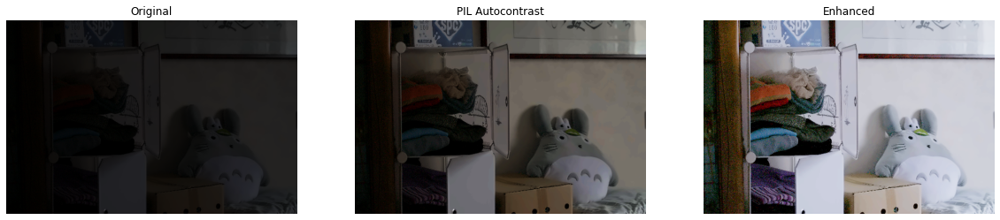

...

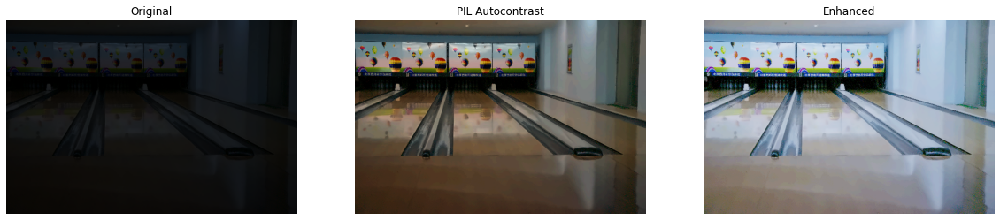

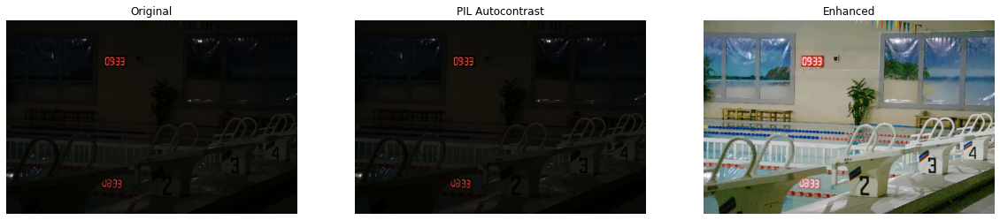

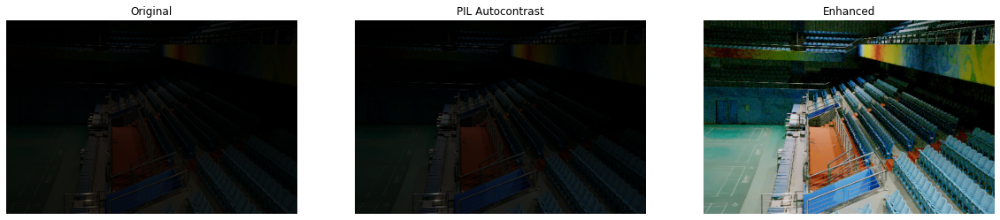

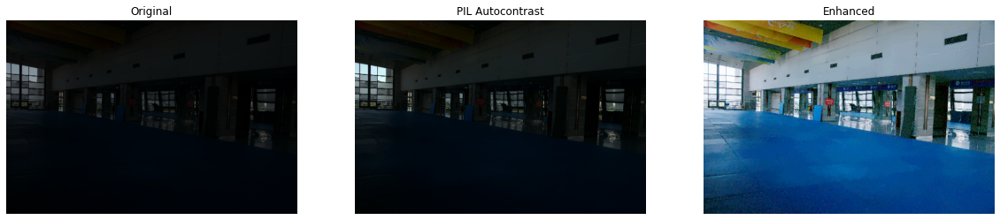

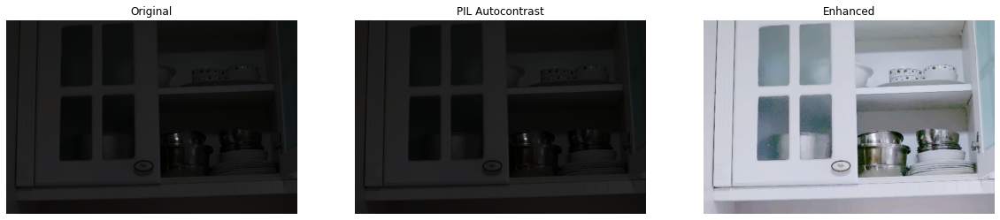

In [18]:
for val_image_file in test_low_light_images:
    original_image = Image.open(val_image_file)
    enhanced_image = infer(original_image)
    plot_results(
        [original_image, ImageOps.autocontrast(original_image), enhanced_image],
        ["Original", "PIL Autocontrast", "Enhanced"],
        (20, 12),
    )